<a href="https://colab.research.google.com/github/kevin40800/Social_Network_Analysis/blob/main/final_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center>
<img src="https://upload.wikimedia.org/wikipedia/fr/thumb/1/1d/Logo_T%C3%A9l%C3%A9com_SudParis.svg/1014px-Logo_T%C3%A9l%C3%A9com_SudParis.svg.png" width="10%" />
</center>

<center> <h2> NET 4103/7431 Complex Network </h2> </center>

<center> <h3> Ke-Wei Cheng (kevin4080048@gmail.com) </h3> </center>
<h1 align="center">Final Project: Graph Neural Networks</h1>
<br />



In [ ]:
NOM = "Cheng"
PRENOM = "Ke-Wei"

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Rectangle
import networkx as nx
import pandas as pd
import numpy as np
import torch
import sys
import os
import glob
import math

# Style pour le Notebook
from IPython.core.display import HTML
# If working in colab mount the drive filesystem
if 'google.colab' in str(get_ipython()):
  import glob
  from google.colab import drive
  print('Working in colab')

  mount_point = '/content/drive' # Always the same, don't change it
  drive.mount(mount_point)
  drive_path = mount_point + '/My Drive/' # Always the same, don't change it

  # Replace the following folder with some folder inside your google drive
  my_path = drive_path + \
    'IP Paris Intership/Graph Learning and Traffic Shared Folder/'
else:
  print("working locally")
  my_path = ""

Working in colab
Mounted at /content/drive


## Load Network

### Load network by gml file

In [ ]:
GraphName = ["Caltech36", "MIT8", "Johns Hopkins55"]
if 'google.colab' in str(get_ipython()):
  path = my_path + "data/"
else:
  path = "./data/"
print("Data Path:",path)
G_FB100_Dic = {}
for graphName in GraphName:
    opeFile = path + graphName +".gml"
    G_FB100_Dic[graphName] = nx.read_gml(opeFile)
    """_summary_
    plt.figure()
    nx.draw_networkx(G_FB100_Dic[fileName])
    plt.axis('off')

    """


Data Path: /content/drive/My Drive/CSN/Graph_Learning/data/


### Load network by pickle file **(faster!)**

In [ ]:
import pickle
def readAllGraphName(path, orgGraphName):

  os.chdir(path)
  fileFormat = "gml"
  GraphNameTotal = orgGraphName.copy()
  for file in glob.glob("*."+fileFormat):
    fileName = file[:-(1+len(fileFormat))]
    if fileName not in GraphNameTotal:
      GraphNameTotal.append(fileName)
  return GraphNameTotal



def loadTotalGraph(path, G_FB100_Dic, GraphNameTotal, LoadNGraph = 15):
  n = 0

  for graphName in GraphNameTotal:
    if graphName not in G_FB100_Dic.keys():
      fileName = graphName+".pickle"
      open_path = path+fileName
      G_FB100_Dic[graphName] = pickle.load(open(open_path, 'rb'))
      n += 1
    if n > LoadNGraph:
      break;


In [ ]:
# load graph object from file
if "G_FB100_Dic" not in locals():
  G_FB100_Dic = {}
loadTotalGraph
GraphName = ["Caltech36", "MIT8", "Johns Hopkins55"]
path = my_path + "data/"
GraphNameTotal = readAllGraphName(path, GraphName)
loadTotalGraph(path, G_FB100_Dic, GraphNameTotal, LoadNGraph = 30)

### Show graph size

In [ ]:
def showTotalGraphSize():
  for graphName in G_FB100_Dic.keys():
    G = G_FB100_Dic[graphName];
    print(graphName,":",len(G.nodes()))
showTotalGraphSize()

Caltech36 : 769
MIT8 : 6440
Johns Hopkins55 : 5180
NYU9 : 21679
Georgetown15 : 9414
Princeton12 : 6596
Reed98 : 962
Stanford3 : 11621
Dartmouth6 : 7694
Emory27 : 7460
Cal65 : 11247
Harvard1 : 15126
Maryland58 : 20871
Williams40 : 2790
Northeastern19 : 13882
USC35 : 17444
Mich67 : 3748
Brandeis99 : 3898
Texas80 : 31560
UIllinois20 : 30809
Wisconsin87 : 23842
BC17 : 11509
Simmons81 : 1518
American75 : 6386
Penn94 : 41554
Tennessee95 : 16979
Auburn71 : 18448
UC61 : 13746
Hamilton46 : 2314
Tulane29 : 7752
Haverford76 : 1446


## Set Color List

In [ ]:
import seaborn as sns
import matplotlib.colors as mcolors
NColor = 20
palette = sns.color_palette(None, NColor+1)
colorList = [(1,0,0), (0,1,0), (0,0,1)] + list(palette);


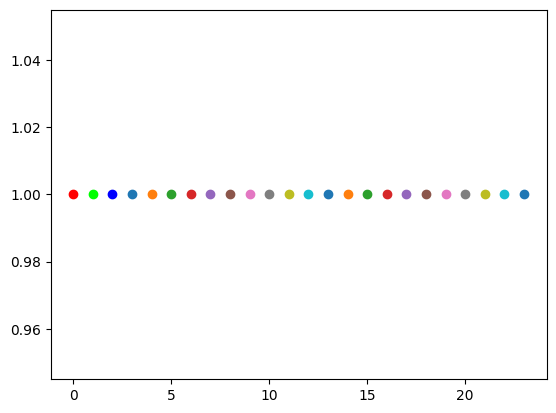

In [ ]:
fog = plt.figure()
x = range(len(colorList));
y = np.ones(len(colorList));
for i in range(len(colorList)):
  plt.plot(x[i],y[i],'o',c=colorList[i])

# Question1

## Reading
Read the following documents
1. Jacobs, A. Z., Way, S. F., Ugander, J. & Clauset, A. Assembling thefacebook: Using
heterogeneity to understand online social network assembly. In Proceedings of the
ACM Web Science Conference, WebSci '15, 18:1{18:10 (2015). URL https://arxiv.org/abs/1503.06772 .
2. Traud, A. L., Kelsic, E. D., Mucha, P. J. & Porter, M. A. Comparing community
structure to characteristics in online collegiate social networks. SIAM Review 53,
526{543 (2011). URL https://arxiv.org/abs/0809.0690 .

3. Traud, A. L., Mucha, P. J. & Porter, M. A. Social structure of facebook networks.
Physica A: Statistical Mechanics and its Applications 391, 4165 { 4180 (2012). URL
https://arxiv.org/abs/1102.2166 .


# Question 2

### Social Network Analysis with the Facebook100 Dataset

The smallest network (Caltech) has 762 nodes in the largest connected component
(LCC), and the largest has more than 40000 nodes in the LCC.
Lets use three networks from the FB100: Caltech (with 762 nodes in the LCC), MIT
(which has 6402 nodes in the LCC), and Johns Hopkins (which has 5157 nodes in
the LCC).

1. For these three networks plot the degree distribution for each of the three net-
works that you downloaded. What are you able to conclude from these degree
distributions?
2. Compute the global clustering coefficient and mean local clustering coefficient
for each of the 3 networks. In addition compute the edge density of each network.
Should either of these networks be construed as sparse? Based on the density
information and the clustering information what can you said about the graph
topology?
3. For each network, also draw a scatter plot of the degree versus local clustering
coefficient. Based on these calculations as well as your previous ones, are you
able to draw any conclusions about any similarities or difference between the
tree networks? What other observations can you make?

### Sub question 1
1. For these three networks plot the degree distribution for each of the three net-
works that you downloaded. What are you able to conclude from these degree
distributions?

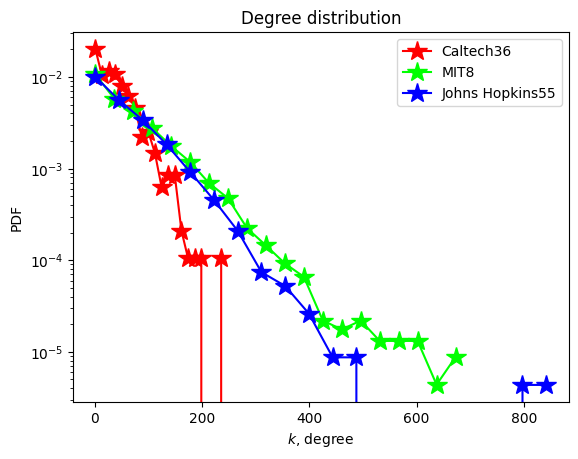

In [ ]:
idx = 0
for graphName in GraphName:
    G = G_FB100_Dic[graphName]
    degree_sequence = sorted([degree for node, degree in G.degree()], reverse=True)  # degree sequence
    hist, bin_edges = np.histogram(degree_sequence, bins=20, density=True)
    #plt.figure(figsize=(10,6))
    plt.semilogy(bin_edges[:-1], hist, '-*', ms=15, c = colorList[idx])
    plt.xlabel(r"$k$, degree ")
    plt.ylabel(r"PDF")
    #plt.ylim(1e-3, 1)
    plt.title("Degree distribution")
    idx += 1;
plt.legend(GraphName)

#### some test code...

In [ ]:
os.chdir(mount_point+"/Othercomputers"+"/我的筆記型電腦"+"/CSN"+"/Network Analysis and Modling_Graph_Learning/ComplexNetTD/release/Lab 4")
!ls


In [ ]:
for graphName in GraphName:
    G = G_FB100_Dic[graphName]
    print(type(G))

<class 'networkx.classes.graph.Graph'>
<class 'networkx.classes.graph.Graph'>
<class 'networkx.classes.graph.Graph'>


In [ ]:
for graphName in GraphName:
    G = G_FB100_Dic[graphName]
    plt.figure()
    nx.draw_networkx(G)
    plt.axis('off')
    """_summary_
    It takes too much time too run...
    """

### Sub question 2
2. Compute the global clustering coefficient and mean local clustering coefficient
for each of the 3 networks. In addition compute the edge density of each network.
Should either of these networks be construed as sparse? Based on the density
information and the clustering information what can you said about the graph
topology?

In [ ]:
def vertexClusterCoef(G,v):
    """Description
    G: Graph
    v: vertex (node)
    Calulate
    """
    v_neighbors = list(G.neighbors(v))

    edges = 0.0
    numOfNeighbors = len(v_neighbors)
    for i in range(numOfNeighbors):
        for j in range(i+1, numOfNeighbors):
            if v_neighbors[j] in G.neighbors(v_neighbors[i]):
                edges += 1
    if edges == 0.0:
        return 0.0
    else:
        return edges / ((numOfNeighbors**2 - numOfNeighbors)/2)

def globalClusterCoef(G):
    nodesList = G.nodes()
    numOfNode = len(nodesList)
    sumOfCC = 0.0
    CC = []
    CCNode = []
    for node in nodesList:
        localCC = vertexClusterCoef(G,node)
        CC.append(localCC)
        CCNode.append(node)
        sumOfCC += localCC
    print(CC)
    list_of_tuples = list(zip(CCNode, CC))
    dfCC = pd.DataFrame(list_of_tuples, columns=["Node","CC"])
    globCC = sumOfCC/numOfNode
    print("Global Cluster Coefficient:",globCC)
    return globCC, dfCC
def globalClusterCoefByLocalCC(CC):
    GCCLocal = {}
    for key in CC.keys():
      ccList = CC[key]["CC"];
      #print(ccList)
      NumOfLocalCC = len(ccList);
      sumOfLocalCC = sum(ccList)
      GCCLocal[key] = sumOfLocalCC/NumOfLocalCC;
    return GCCLocal;

def graphDensity(G):
    numOfNodes = G.number_of_nodes()
    return G.number_of_edges()/(numOfNodes*(numOfNodes-1)/2)

In [ ]:
GDensity = {}
for graphName in GraphName:
    G = G_FB100_Dic[graphName]
    GDensity[graphName] = graphDensity(G)

print(GDensity)

{'Caltech36': 0.05640442132639792, 'MIT8': 0.012118119495041378, 'Johns Hopkins55': 0.013910200162372396}


In [ ]:
if "GCC" not in locals():
  GCC = {};
if "CC" not in locals():
  CC = {};
test=['Caltech36']

for graphName in GraphName:
    G = G_FB100_Dic[graphName]
    """Description
    G: Graph
    v: vertex (node)
    Calulate
    """
    GCC_local, CC_local = globalClusterCoef(G)
    if graphName not in CC.keys():
      CC[graphName] = CC_local;
    if graphName not in GCC.keys():
      GCC[graphName] = GCC_local;

    #print("Node: ",node,"Neighbor:",neighbor)
print(GCC)

[0.26055599265670076, 0.363382250174703, 0.38095238095238093, 0.2761904761904762, 0.35185185185185186, 0.5058823529411764, 0.3333333333333333, 0.493993993993994, 0.0, 0.3560606060606061, 0.0, 0.317429406037001, 1.0, 0.32932469935245146, 0.6038461538461538, 0.2766453115899825, 0.5735294117647058, 0.20540540540540542, 1.0, 0.4950166112956811, 0.30697278911564624, 0.36363636363636365, 0.6363636363636364, 0.6666666666666666, 0.31061213579256886, 0.35517970401691334, 0.263681592039801, 0.5163398692810458, 0.5844155844155844, 0.36470588235294116, 0.34078947368421053, 0.8055555555555556, 0.47058823529411764, 0.0, 0.0, 0.3441358024691358, 0.3333333333333333, 0.5930232558139535, 0.36586791350087666, 1.0, 0.5241379310344828, 0.33249299719887954, 0.35720375106564367, 0.42063492063492064, 0.2686868686868687, 0.3181818181818182, 0.36551724137931035, 0.5064011379800853, 0.5362903225806451, 0.4473684210526316, 0.2, 0.3968253968253968, 0.5249709639953543, 0.2850574712643678, 0.5714285714285714, 0.3264

In [ ]:
for graphName in GraphName:
  if "GCC" not in locals():
    GCC = globalClusterCoefByLocalCC(CC)
  else:
    break;
print(GCC)

{'Caltech36': 0.40929439048517247, 'MIT8': 0.2712187419501315, 'Johns Hopkins55': 0.26839307371293525}


In [ ]:
for graphName in GraphName:
  csvFileName = my_path + "ClusterCoefficient_" + graphName +".csv"
  df = CC[graphName];
  df.to_csv(csvFileName, index=False)

In [ ]:
CC1={};
for graphName in GraphName:
  csvFileName = my_path + "ClusterCoefficient_" + graphName +".csv"
  df = pd.read_csv(csvFileName)
  CC1[graphName] = df;
if "CC" not in locals():
  CC = CC1;

In [ ]:
clusterCoef = list(CC[graphName]['CC'])
print(clusterCoef)

[0.1964165733482643, 0.1845238095238095, 0.3854502087060226, 0.2576896787423103, 0.2505235103750238, 0.1050724637681159, 0.1911764705882352, 0.1622971285892634, 0.3891625615763547, 0.3476190476190476, 0.3630952380952381, 0.2560975609756097, 0.3396825396825397, 0.5555555555555556, 0.3101217656012177, 0.2982890125747268, 0.3300492610837438, 0.1579914396074747, 0.2872072072072072, 0.3076923076923077, 0.3092006033182504, 0.1939393939393939, 0.512735326688815, 0.2575452716297787, 0.3724770642201835, 0.181023720349563, 0.238095238095238, 0.3350877192982456, 0.1691176470588235, 0.1339977851605758, 0.0, 0.1791159067177166, 0.1351236146632566, 0.3428571428571428, 0.1586239847109412, 0.1650570676031606, 0.227874276261373, 0.196124486200822, 0.0, 0.1022671568627451, 0.1899801587301587, 0.2218354430379746, 0.3255813953488372, 0.241851106639839, 0.0, 0.3689858082381447, 0.3112507138777841, 0.225071225071225, 0.2160278745644599, 0.2679738562091503, 0.3049001814882032, 0.1817430993262334, 0.140350877

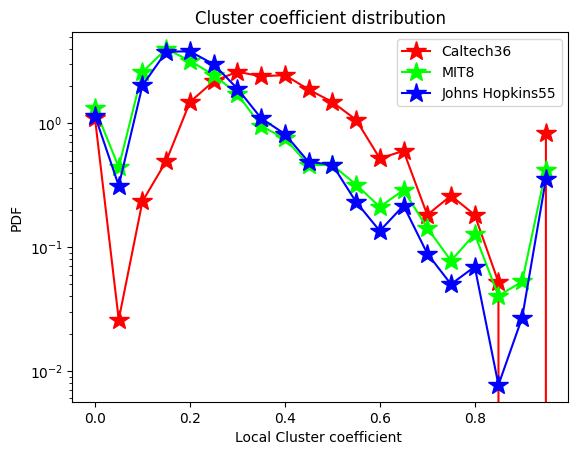

In [ ]:
plt.figure()
i = 0;
for graphName in GraphName:
  clusterCoef = list(CC[graphName]['CC'])
  hist, bin_edges = np.histogram(clusterCoef, bins=20, density=True)
  #plt.figure(figsize=(10,6))
  plt.semilogy(bin_edges[:-1], hist, '-*', ms=15, c=colorList[i])
  plt.xlabel(r"Local Cluster coefficient ")
  plt.ylabel(r"PDF")
  #plt.ylim(1e-3, 1)
  plt.title("Cluster coefficient distribution")
  i+=1;
plt.legend(GraphName)

In [ ]:
df.head()

,Node,CC
0,0,0.260556
1,1,0.363382
2,2,0.380952
3,3,0.276190
4,4,0.351852


**Plot the Graph**

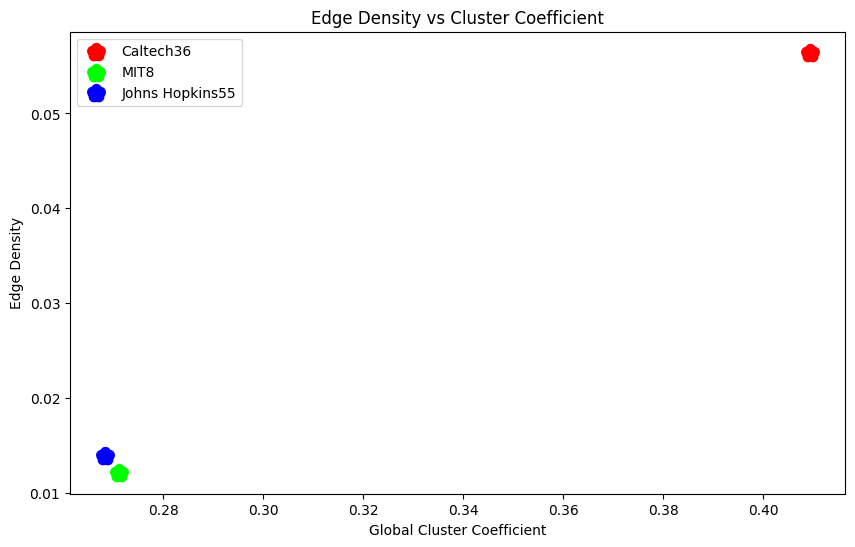

In [ ]:
gcc = []
gdensity = []
plt.figure(figsize=(10,6))
plt.xlabel(r"Global Cluster Coefficient")
plt.ylabel(r"Edge Density")
#plt.ylim(1e-3, 1)
plt.title("Edge Density vs Cluster Coefficient")
i = 0
for graphName in GraphName:

  gcc.append(GCC[graphName])
  gdensity.append(GDensity[graphName])
  plt.scatter(x=gcc[-1],y=gdensity[-1],marker="*",linewidth=8, color=colorList[i])
  i+=1;

plt.legend(GraphName)

In caltech, the graph density and

### Sub question 3

3. For each network, also draw a scatter plot of the degree versus local clustering
coefficient. Based on these calculations as well as your previous ones, are you
able to draw any conclusions about any similarities or difference between the
tree networks? What other observations can you make?

In [ ]:
for graphName in GraphName:
  G = G_FB100_Dic[graphName]
  degree_sequence = list([degree for node, degree in G.degree()])  # degree sequence
  CC[graphName]["degree"] = degree_sequence
  #CC[graphName].insert(-1, "degree", degree_sequence, True)



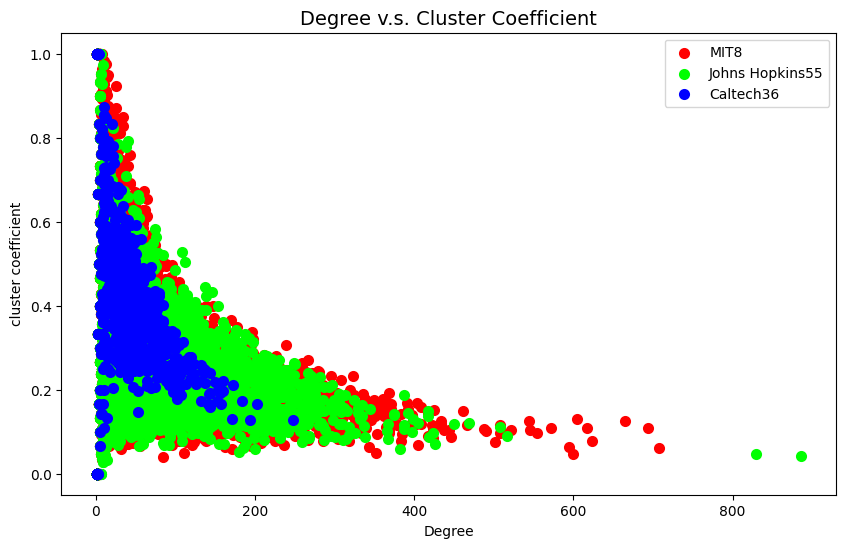

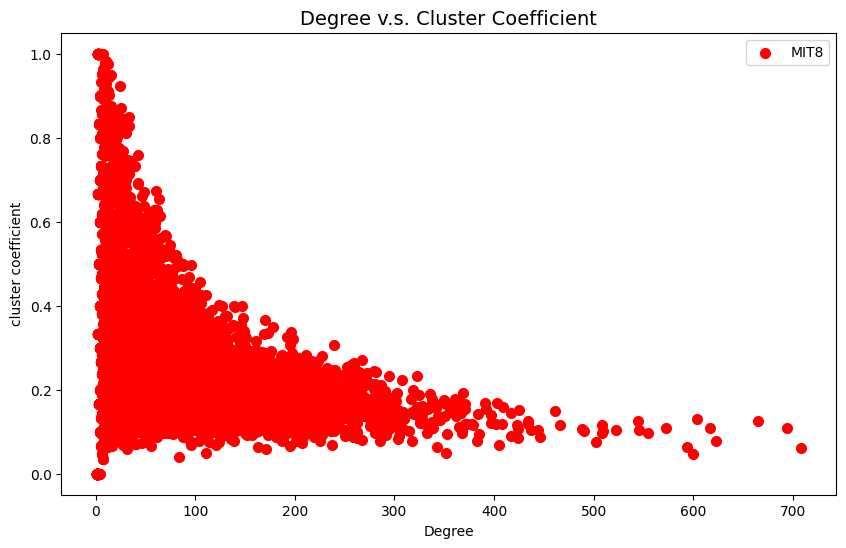

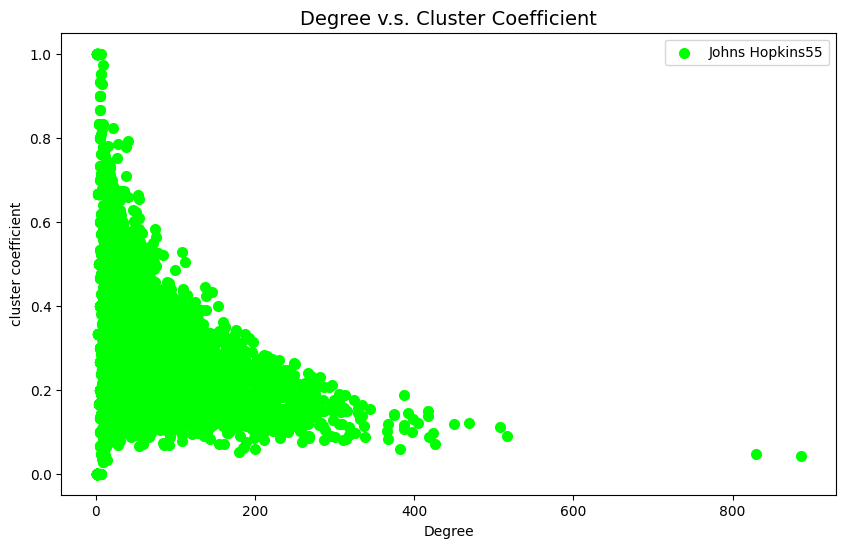

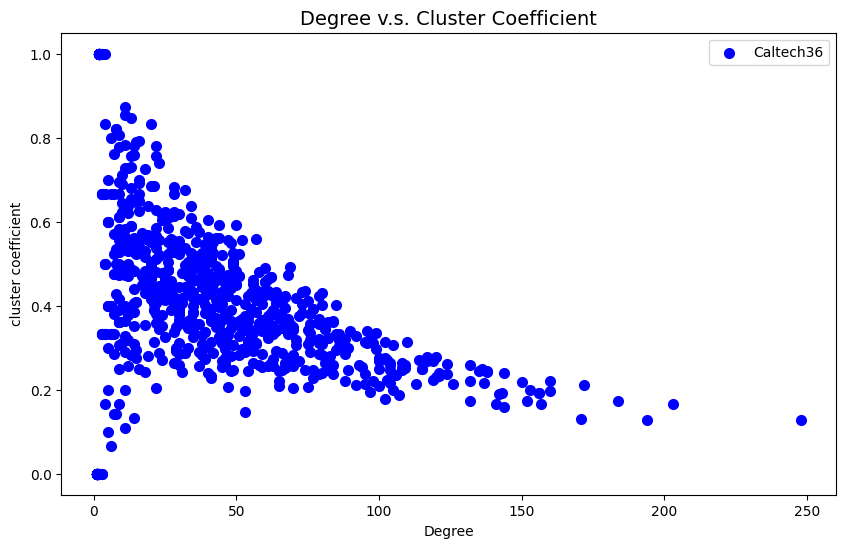

In [ ]:
plt.figure(figsize=(10,6))
#colorList = ['tab:blue','tab:orange','tab:green']
GraphName = ['MIT8', 'Johns Hopkins55','Caltech36']

i = 0;
for graphName in GraphName:

  plt.scatter(x=CC[graphName]["degree"],y=CC[graphName]["CC"],linewidth=2,c=colorList[i])
  plt.xlabel(r"Degree")
  plt.ylabel(r"cluster coefficient")
  plt.title(r"Degree v.s. Cluster Coefficient",fontsize=14)
  i += 1
plt.legend(GraphName)

i = 0;
for graphName in GraphName:

  plt.figure(figsize=(10,6))
  plt.scatter(x=CC[graphName]["degree"],y=CC[graphName]["CC"],linewidth=2,c=colorList[i])
  plt.xlabel(r"Degree")
  plt.ylabel(r"cluster coefficient")
  plt.legend([graphName]);
  plt.title(r"Degree v.s. Cluster Coefficient",fontsize=14)
  i = i + 1;


#### some test code....

In [ ]:
for graphName in GraphName:
    G = G_FB100_Dic[graphName]
    """Description
    G: Graph
    v: vertex (node)
    Calulate
    """
    nodesList = G.nodes()
    print(nodesList)
    count = 0
    for node in G.nodes():
        neighbor =  [n for n in G.neighbors(node)]
        for n in neighbor:
            if n in G.neighbors(node):
                count = count+1
        #print("Node: ",node,"Neighbor:",neighbor)

    """
    for i in range(len(v_neighbors)):
        for j in range(i+1, len(v_neighbors)):
            if v_neighbors[j] in G[v_neighbors[i]]:
                edges += 1
    if edges == 0.0:
        return 0.0
    else:
        return edges / ((len(v_neighbors)**2 - len(v_neighbors))/2)
    """


['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99', '100', '101', '102', '103', '104', '105', '106', '107', '108', '109', '110', '111', '112', '113', '114', '115', '116', '117', '118', '119', '120', '121', '122', '123', '124', '125', '126', '127', '128', '129', '130', '131', '132', '133', '134', '135', '136', '137', '138', '139', '140', '141', '142', '143', '144', '145', '146', '147', '148', '149', '150', '151', '152', '153', '154', '155', '156', '157', '15

In [ ]:
print(len(CC['Caltech36']))
print(len())

769

# Question 3

## Assortativity Analysis with the Facebook100 Dataset

In this question we expect you will compute the assortativity on a large set of graphs (if possible all the graphs).


1. Of the FB100 networks, investigate the assortativity patterns for five vertex attributes:
</br>(i)  student/faculty status
</br>(ii) major
</br>(iii) vertex degree
</br>(iiii) dorm
</br>(iiiii) gender.
</br>Treat these networks as simple graphs in your analysis. For each vertex attribute, make a scatter plot showing __the assortativity versus
network size n(total number of nodes)__, with __log-linear axes__ for all 100 networks, and a histogram or density plot showing the distribution of assortativity values. In both figures, include a line indicating no assortativity. Briefly discuss the degree to which
vertices do or do not exhibit assortative mixing on each attribute, and speculate about what kind of processes or tendencies in the formation of Facebook friendships might produce this kind of pattern. For example, below are figures for assortativity by gender on these networks. The distribution of points spans the line of no assortativity, with some values nearly as far below 0 as others are
above 0. However, the gender attributes do appear to be slightly assortative in these social networks: although all values are within 6% in either direction of 0, the mean assortativity is 0.02, which is slightly above 0. This suggests a slight amount of homophily by gender (like links with like) in the way people friend each other on Facebook, although the tendency is very weak. In some schools,
we see a slight tendency for heterophily (like links with dislike), as one might expect if the networks reflected heteronormative dating relationships.



In [ ]:
TotalGraphName = []

os.chdir(path)
fileFormat = "gml"
GraphNameTotal = []
GraphNameTotal = GraphName.copy()
readNum = 8;
idx = 0;
for file in glob.glob("*."+fileFormat):
  fileName = file[:-(1+len(fileFormat))]
  if fileName not in GraphNameTotal:
    GraphNameTotal.append(fileName)
  else:
    print("File:%s is in the list" %(file))

  if fileName not in G_FB100_Dic.keys():
    #cool = []
    G_FB100_Dic[fileName] = nx.read_gml(path+file)
    idx += 1;
  else:
    print("Graph %s is read" %(fileName))
  if idx > readNum:
    break;



In [ ]:
print(GraphNameTotal)

In [ ]:
dfAssort['graph_size']

Caltech36           16656
MIT8               251252
Johns Hopkins55    186586
NYU9               715715
Georgetown15       425638
                    ...  
Wake73             279191
UPenn7             686501
Middlebury45       124610
Vassar85           119161
William77          266378
Name: graph_size, Length: 100, dtype: int64

In [ ]:
attributes = ['student_fac', 'gender', 'major_index', 'second_major', 'dorm', 'year', 'high_school']
dfRow = ["graph_size"] + attributes
dfAssort = pd.DataFrame(index=dfRow, columns=GraphNameTotal,dtype='float')
dfAssort.loc['graph_size',:] = np.array([G_FB100_Dic[graphName].size() for graphName in GraphName]).astype("float64")
dfAssort.head(10)

In [ ]:

if "dfAssort" not in locals():
for attr in attributes:
  for graphName in GraphName: #read all graph and calculate specific attribute
    G = G_FB100_Dic[graphName]
    assort = nx.attribute_assortativity_coefficient(G, attr, nodes=None)
    dfAssort.loc[attr,graphName] = assort

    #print("Attr:%s Graph:%s assort:%f" %(attr,graphName,assort))

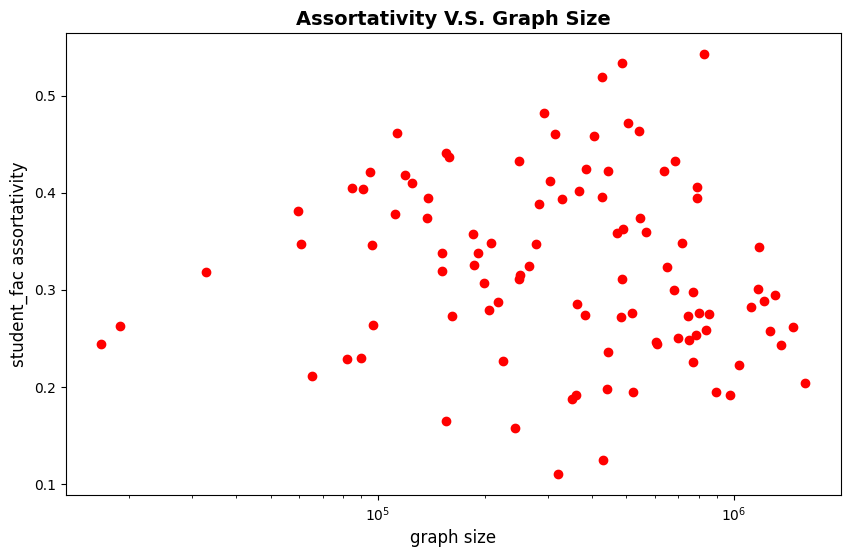

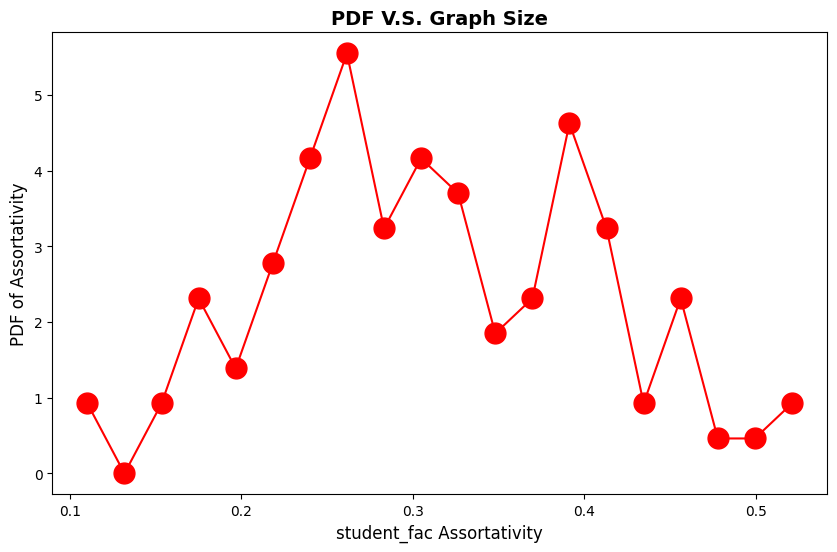

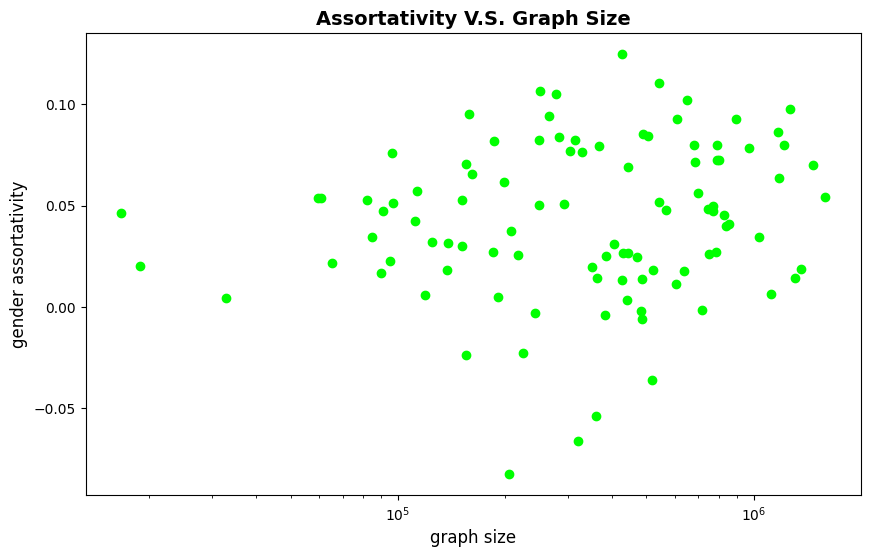

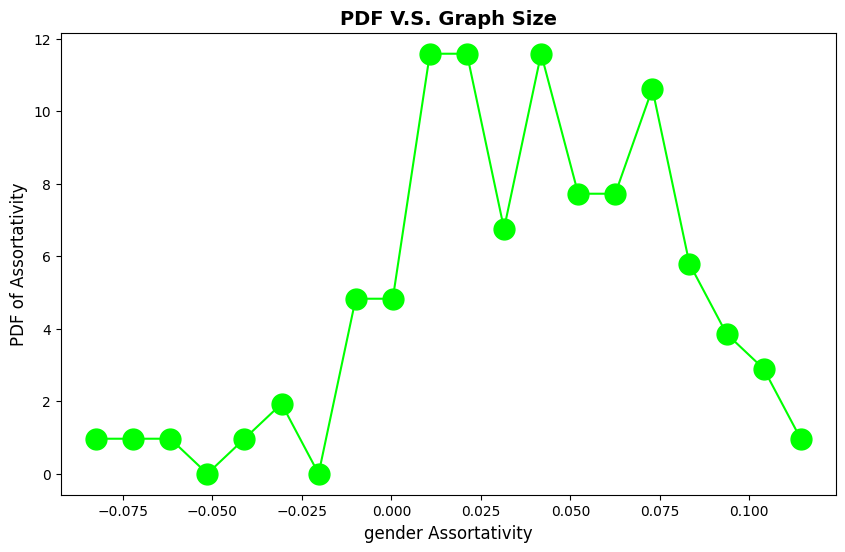

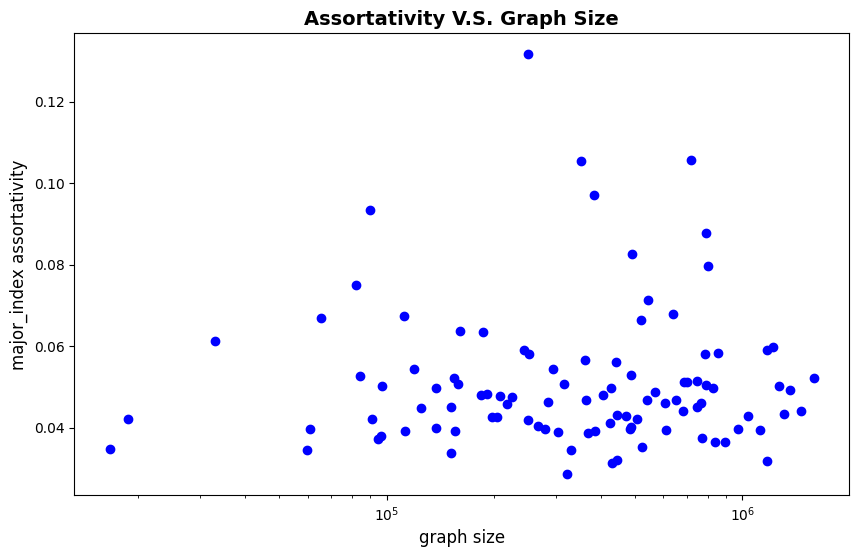

...

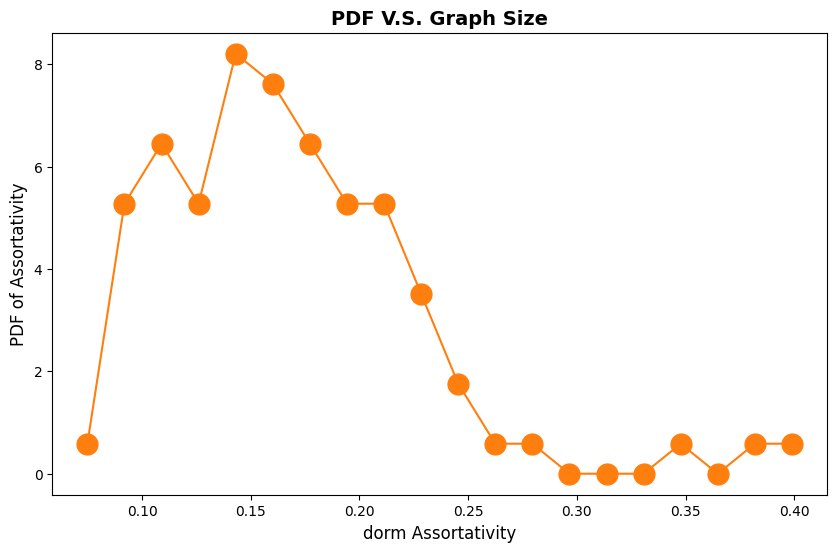

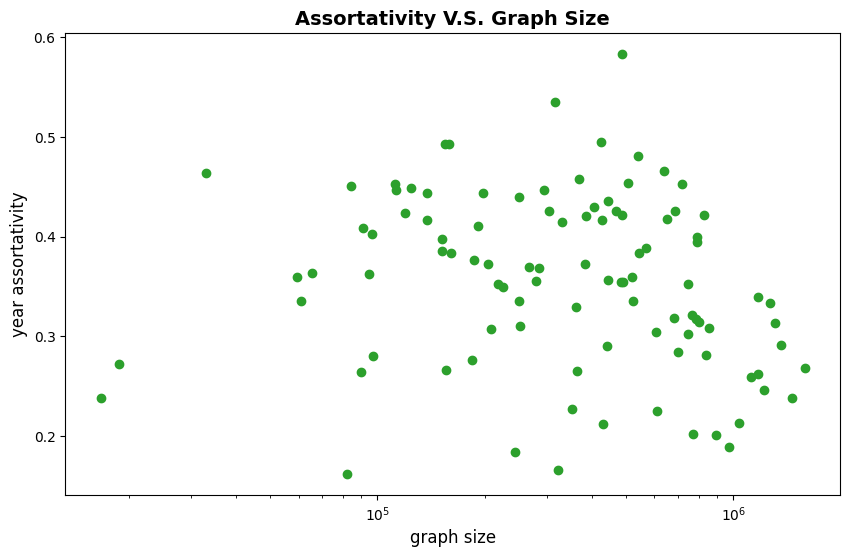

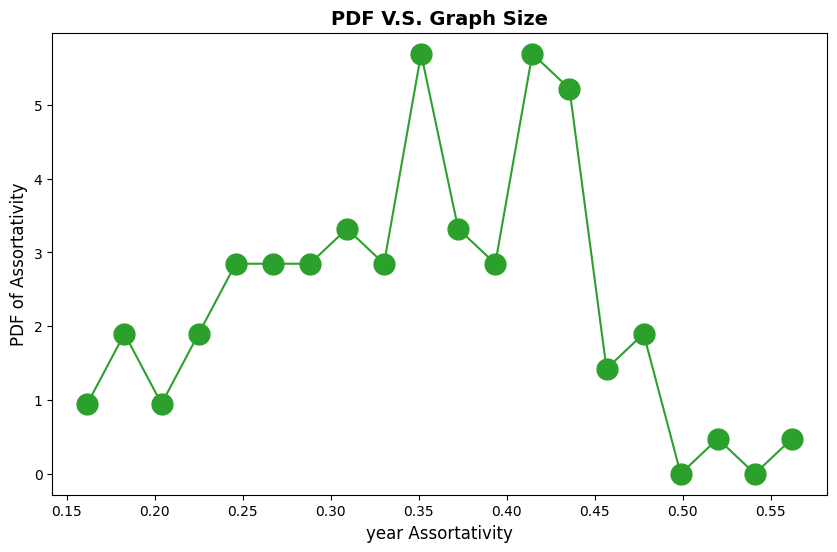

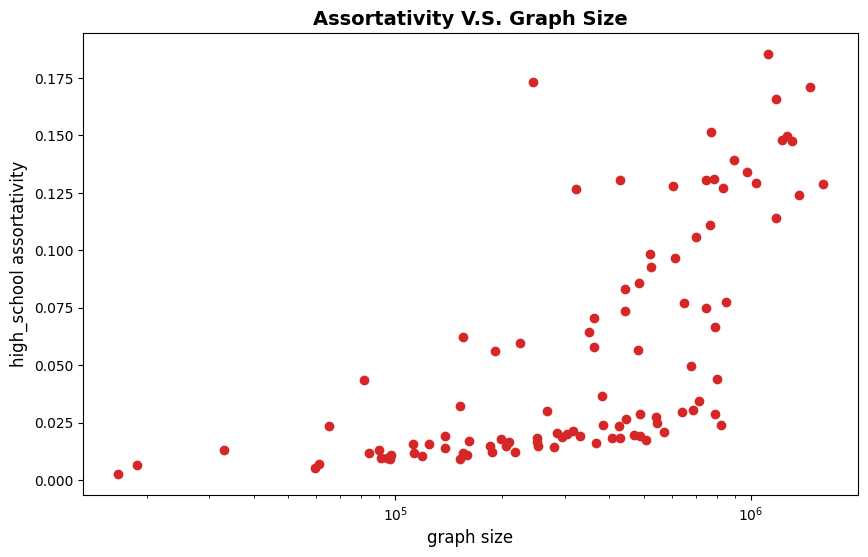

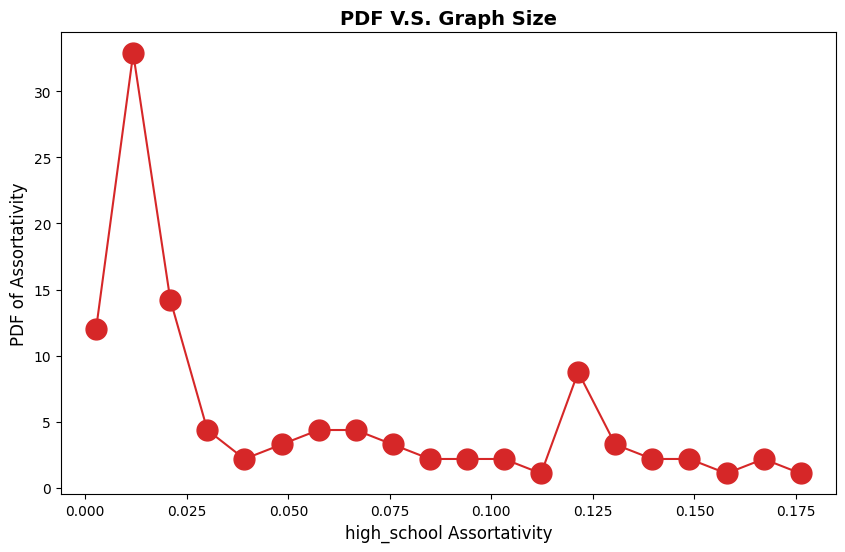

In [ ]:
i = 0;
for attr in attributes:
  plt.figure(figsize=(10,6))
  plt.title("Assortativity V.S. Graph Size",fontsize=14,fontweight="bold")
  plt.xlabel("graph size",fontsize=12)
  plt.ylabel(attr+" assortativity",fontsize=12)
  plt.xscale("log")
  plt.scatter(x=dfAssort.loc['graph_size',:],y=dfAssort.loc[attr,:],c=colorList[i])

  #plot pdf of assortaitvity of differnet attribute
  hist, bin_edges = np.histogram(dfAssort.loc[attr,:].to_numpy(), bins=20, density=True)
  plt.figure(figsize=(10,6))
  plt.title("PDF V.S. Graph Size",fontsize=14,fontweight="bold")
  plt.ylabel("PDF of Assortativity",fontsize=12)
  plt.xlabel(attr+ " Assortativity",fontsize=12)
  plt.plot(bin_edges[:-1], hist, '-o', ms=15, c=colorList[i])
  i += 1;

### Load and Save Data

#### Save Assortativity Dataset

In [ ]:
#save dataframe

dfAssort.to_pickle(my_path+"Assort1.pkl")

In [ ]:
#read df data

dfAssort1 = pd.read_pickle(my_path+"Assort1.pkl")
if "dfAssort" not in locals():
  dfAssort = dfAssort1;

#### Save and Load Graph Data

In [ ]:
#save graph
import pickle
for graphName in GraphName:
  G = G_FB100_Dic[graphName]
  fileName = graphName+".pickle"
  save_path = path+fileName
  pickle.dump(G, open(save_path, 'wb'))
  print(save_path)

In [ ]:
list([key for key in G_FB100_Dic.keys()])


In [ ]:
import pickle
def readAllGraphName(path, orgGraphName):

  os.chdir(path)
  fileFormat = "gml"
  GraphNameTotal = orgGraphName.copy()
  for file in glob.glob("*."+fileFormat):
    fileName = file[:-(1+len(fileFormat))]
    if fileName not in GraphNameTotal:
      GraphNameTotal.append(fileName)
  return GraphNameTotal



def loadTotalGraph(path, G_FB100_Dic, GraphNameTotal, LoadNGraph = 15):
  n = 0

  for graphName in GraphNameTotal:
    if graphName not in G_FB100_Dic.keys():
      fileName = graphName+".pickle"
      open_path = path+fileName
      G_FB100_Dic[graphName] = pickle.load(open(open_path, 'rb'))
      n += 1
    if n > LoadNGraph:
      break;


In [ ]:
# load graph object from file
if "G_FB100_Dic" not in locals():
  G_FB100_Dic = {}
loadTotalGraph
GraphName = ["Caltech36", "MIT8", "Johns Hopkins55"]
path = my_path + "data/"
GraphNameTotal = readAllGraphName(path, GraphName)
loadTotalGraph(path, G_FB100_Dic, GraphNameTotal, LoadNGraph = 15)

#### some test code...

In [ ]:
for graphName in GraphName:
  G = G_FB100_Dic[graphName]
  nodeList = [nodes for nodes in G.nodes()]
  print(G.nodes[nodeList[0]].keys())
  #print(list(list(G.edges(data=True))[0][-1].keys()))
  edgeAttrList = [attr for u,v,attr in G.edges(data=True)]
  #print(edgeList)
  print(edgeAttrList[0].keys())
  #nodeList = [nodes for nodes in G.nodes()]
  #print(list(G[nodeList[0]].keys()))
  break;


dict_keys(['student_fac', 'gender', 'major_index', 'second_major', 'dorm', 'year', 'high_school'])
dict_keys([])


In [ ]:
import glob, os
#opeFile = path + graphName +".gml"
#G_FB100_Dic[graphName] = nx.read_gml(opeFile)
os.chdir(path)
fileFormat = "gml"
GraphNameTotal = []
GraphNameTotal = GraphName
for file in glob.glob("*."+fileFormat):
  fileName = file[:-(1+len(fileFormat))]
  if fileName not in GraphNameTotal:
    GraphNameTotal.append(fileName)
  else:
    print("File:%s is in the list" %(file))

  if fileName in G_FB100_Dic.keys():
    print("Graph %s is read" %(fileName))

  #print(file[:-(1+len(fileFormat))])#Truncate the file format part and leave the file names only.

File:Caltech36.gml is in the list
Graph Caltech36 is read
File:Johns Hopkins55.gml is in the list
Graph Johns Hopkins55 is read
File:MIT8.gml is in the list
Graph MIT8 is read


In [ ]:
print(GraphNameTotal)

['Caltech36', 'MIT8', 'Johns Hopkins55', 'NYU9.gml', 'Georgetown15.gml', 'Princeton12.gml', 'Reed98.gml', 'Stanford3.gml', 'Dartmouth6.gml', 'Emory27.gml', 'Cal65.gml', 'Harvard1.gml', 'Maryland58.gml', 'Williams40.gml', 'Northeastern19.gml', 'USC35.gml', 'Mich67.gml', 'Caltech36.gml', 'Brandeis99.gml', 'Texas80.gml', 'UIllinois20.gml', 'Wisconsin87.gml', 'BC17.gml', 'Simmons81.gml', 'American75.gml', 'Penn94.gml', 'Tennessee95.gml', 'Auburn71.gml', 'UC61.gml', 'Hamilton46.gml', 'Tulane29.gml', 'Haverford76.gml', 'UC33.gml', 'UMass92.gml', 'Amherst41.gml', 'WashU32.gml', 'Oklahoma97.gml', 'Villanova62.gml', 'UNC28.gml', 'BU10.gml', 'Wesleyan43.gml', 'Trinity100.gml', 'Vermont70.gml', 'Virginia63.gml', 'Northwestern25.gml', 'UGA50.gml', 'Michigan23.gml', 'Cornell5.gml', 'Bucknell39.gml', 'UCSD34.gml', 'Wellesley22.gml', 'Mississippi66.gml', 'Carnegie49.gml', 'Johns Hopkins55.gml', 'Brown11.gml', 'Baylor93.gml', 'Maine59.gml', 'USFCA72.gml', 'Berkeley13.gml', 'Rochester38.gml', 'UCSC68.g

In [ ]:
x=np.array([G_FB100_Dic[graphName].size() for graphName in GraphName])
dfAssort.loc[:,'graph_size'] = x

# Question 4

## Link Prediction
In this question we expect you will compute the link prediction algorithms on a large set of graphs (> 10).
1. Read the following documents [4]
</br> *Liben-Nowell, D. & Kleinberg, J. The link prediction problem for social networks.
In Proceedings of the Twelfth International Conference on Information and Know-ledge Management, CIKM '03, 556{559 (2003). URL https://www.cs.cornell.edu/home/kleinber/link-pred.pdf.*
2. Implement the following link prediction metrics: common neighbors, jaccard, Ad-
amic/Adar. We use the scikit-learn2 API as an example for our implementation
of the link prediction metrics. Please use the implementation (in listing. 1) as
an example. Your implementation should inherit from the class LinkPrediction defined in listing. 1. __<font color='red'>You should implement yourself the given metrics,don't used the ones defined in Networkx</font>__
3. Evaluating a link predictor:
  1. Select graph $G_{fb}(V,E)$ in the Facebook100 dataset
  2. randomly remove a given fraction $f∈[0.05, 0.1, 0.15, 0.2]$ of edges $E_{removed}$ from the original graph $G_{b}$
  3. For each node pair in the graph $|V|×|V|$, for each node pair compute the link predicor metrics of interest p, these are the predicted "friendship" $E_{predict}$.
  4. Sort in decreasing order of confidence as a function $p$ from the node pair $E_{predict}$ and then we take the first k pairs of nodes $E^{top@k}_{predict}$.
  5. Compute the size of the intersection between the edge set of removed edges and the edge set of predicted node $E_{removed} \cap E^{top@k} _{predict}$ . Then compute the __top@k, recall@k and precision@k__ (for k = 50,100,200,...,400) using the k best scored edges provided by link predictor algorithm (see [5] for more information). Where the top@k predictive rate is the percentage of correctly classfied positive samples among the top __k__ instances in the ranking produced by a link predictor $P$.
</br> $P_{precision}= |TP|/(|TP|+|FP|)$
</br> $P_{reall}= |TP|/(|TP|+|FN|)$
4. Choose a couple of graphs in the facebook100 dataset run and evaluate each link predictor on them, and conclude on the efficiency of the following metrics:common neighbors, jaccard, Adamic/Adar.

In [ ]:
!pip install scikit-network
!pip install torch_geometric
!pip install mlflow
!pip install dgl
import dgl
import torch
import torch.nn as nn
import torch.nn.functional as F
import itertools
import numpy as np
import scipy.sparse as sp
import networkx as nx
from packaging import version
import sknetwork as skn
import sklearn
import torch_geometric
from torch_geometric.utils.convert import from_networkx

print("Python version:", sys.version)
print("networkx version:", nx.__version__)
print("sklearn version:", sklearn.__version__)
print("torch version:", torch.__version__)
print("torch_geometric version:", torch_geometric.__version__)


# assert networkx version is greater or equal to 2.6
assert version.parse(nx.__version__) >= version.parse("2.6")

# assert torch version is greater or equal to '1.10.0'
assert version.parse(torch.__version__) >= version.parse("1.10.0")

# assert torch_geometric version is greater or equal to '2.1.0'
assert version.parse(torch_geometric.__version__) >= version.parse("2.1.0")

# assert scikit-learn version is greater to '1.1.3'
assert version.parse(sklearn.__version__) >= version.parse("1.1.3")

# assert python version is greater that 3.7
assert sys.version_info[0] == 3
assert sys.version_info[1] >= 9

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.5/19.5 MB 35.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 195.4/195.4 kB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.4/233.4 kB 24.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.6/147.6 kB 18.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.2/80.2 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.5/6.5 MB 19.2 MB/s eta 0:00:00


DGL backend not selected or invalid.  Assuming PyTorch for now.


Setting the default backend to "pytorch". You can change it in the ~/.dgl/config.json file or export the DGLBACKEND environment variable.  Valid options are: pytorch, mxnet, tensorflow (all lowercase)
Python version: 3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]
networkx version: 3.2.1
sklearn version: 1.2.2
torch version: 2.1.0+cu121
torch_geometric version: 2.5.0


## class example

In [ ]:
from torch_geometric.nn import SAGEConv
import torch.nn.functional as F

class SAGELinkPreditor(torch.nn.Module):
    def __init__(self, c_in, c_hidden, c_out, dp_rate_linear=0.5):

        super(SAGELinkPreditor, self).__init__()

        self.sage1 = SAGEConv(c_in, c_hidden, normalize=False)
        self.batchnorm = torch.nn.BatchNorm1d(c_hidden)
        self.sage2 = SAGEConv(c_hidden, c_hidden, normalize=False)
        self.dropout = dp_rate_linear

    def reset_parameters(self):
        self.sage1.reset_parameters()
        self.sage2.reset_parameters()

    def encode(self, x, edge_index):
        ### BEGIN SOLUTION
        x = self.sage1(x, edge_index)
        x = self.batchnorm(x)
        x = F.dropout(x, p=self.dropout, training=self.training)
        x = F.relu(x)
        x = self.sage2(x, edge_index)
        return x
        ### END SOLUTION

    def decode(self, z, edge_label_index):
        # cosine similarity
        return (z[edge_label_index[0]] * z[edge_label_index[1]]).sum(dim = -1)

In [ ]:
from tqdm import tqdm
from torch_geometric.utils import negative_sampling
from torch_geometric.loader import NeighborLoader

def train(train_loader, model, optimizer, criterion, device="cpu", frac_neg=1):
    """
    Single epoch model training in batches.
    :return: total loss for the epoch
    """
    model.train()
    total_examples = total_loss = 0
    for batch in train_loader:
        optimizer.zero_grad()
        batch = batch.to(device)
        batch_size = batch.batch_size

        # generate embeddings
        z = model.encode(batch.x, batch.edge_index)

        # generate fake edges
        neg_edge_index = negative_sampling(edge_index = batch.edge_index,
                            num_nodes = batch.num_nodes,
                            num_neg_samples = int(frac_neg*batch.edge_index.size(1)),
                            method = 'sparse')

        # concatenate the real and the fake edges
        edge_label_index = torch.cat([batch.edge_index, neg_edge_index], dim = -1)

        # create the grounth true label
        edge_label = torch.cat([torch.ones(batch.edge_index.size(1)), torch.zeros(neg_edge_index.size(1))], dim = 0)

        # compute the cosine similarity between two node embeddings
        out = model.decode(z, edge_label_index).view(-1)

        # compute the loss
        loss = criterion(out, edge_label)

        # standard torch mechanics here
        # backpropagation
        loss.backward()
        # gradient descent step
        optimizer.step()

        total_examples += batch_size
        total_loss += float(loss) * batch_size
    return total_loss / total_examples

In [ ]:
from sklearn.metrics import roc_auc_score, f1_score, accuracy_score
import numpy as np

@torch.no_grad()
def test(loader, model, device="cpu"):
    """
        Evalutes the model on the test set.
    :param loader: the batch loader
    :return: a score
    """
    model.eval()
    scores = []
    mean_auc = []
    mean_acc = []
    threshold = torch.tensor([0.7])
    for batch in loader:
        batch.to(device)
        # Positive sample
        z = model.encode(batch.x, batch.edge_index)


        # negative sample
        neg_edge_index = negative_sampling(edge_index = batch.edge_index,
                            num_nodes = batch.num_nodes,
                            num_neg_samples = None,
                            method = 'sparse')


        # concatenate the real and the fake edges
        edge_label_index = torch.cat([batch.edge_index, neg_edge_index], dim = -1)

        # create the grounth true label
        edge_label = torch.cat([torch.ones(batch.edge_index.size(1)), torch.zeros(neg_edge_index.size(1))], dim = 0)


        out = model.decode(z, edge_label_index).view(-1).sigmoid()
        pred = (out > threshold).float() * 1

        # score
        score = f1_score(edge_label, pred.cpu().numpy())
        auc = roc_auc_score(edge_label, pred.cpu().numpy(), average=None)
        acc = accuracy_score(edge_label, pred.cpu().numpy())

        mean_auc.append(auc)
        scores.append(score)
        mean_acc.append(acc)
    return np.average(scores), np.average(mean_auc), np.average(acc)

In [ ]:
from torch.utils.tensorboard import SummaryWriter
from tqdm import trange
from datetime import datetime

def run_link_prediction(data, emb_size = 50, dropout = 0.5, n_epoch = 100, lr = 0.001, frac_neg=1):
    # run name
    run_id = int(datetime.timestamp(datetime.now()))
    comment = f" Link prediction run_id={run_id} n_epoch = {n_epoch}, lr = {lr}, emb_size = {emb_size}, dropout = {dropout}"

    # Tensor board
    writer = SummaryWriter(comment=comment)

    # Sample the graph
    train_loader = NeighborLoader(data, input_nodes=data.train_mask, num_neighbors=[20, 30], shuffle=True, batch_size=10)
    test_loader = NeighborLoader(data, input_nodes=data.test_mask, num_neighbors=[20, 30], shuffle=True, batch_size=10)
    val_loader = NeighborLoader(data, input_nodes=data.val_mask, num_neighbors=[20, 30], shuffle=True, batch_size=10)

    # Initialize the model
    model = SAGELinkPreditor(dataset.num_features, emb_size, emb_size, dropout)

    # Optimizer
    optimizer = torch.optim.Adam(params = model.parameters(), lr=lr)

    # BCELoss creates a criterion that measures the Binary Cross Entropy between the target and the output.
    criterion = torch.nn.BCEWithLogitsLoss()
    print(f"*** start the training: {comment} ***")
    best_test_f1, best_val_f1, test_auc, best_test_acc, best_model = 0.0, 0.0,0.0, 0.0, ""
    for epoch in range(n_epoch):
        loss = train(train_loader, model, optimizer, criterion, frac_neg=frac_neg)
        val_f1, val_auc, val_acc = test(val_loader, model)
        test_f1, test_auc, test_acc = test(test_loader, model)
        # compute the best metric
        if val_f1 > best_val_f1:
            best_val_f1 = val_f1
            best_test_f1 = test_f1
            best_test_auc = test_auc
            best_test_acc = test_acc
            best_model = model
        print(f"Epoch {epoch:03d} training loss {loss:.2f}, validation F1 Score: {val_f1}, test F1 Score: {test_f1}")
        writer.add_scalar('Loss/train', loss, epoch)
        writer.add_scalar('F1Score/validation', val_f1, epoch)
        writer.add_scalar('F1Score/test', test_f1, epoch)
        writer.add_scalar('AUC/test', test_auc, epoch)
        writer.add_scalar('AUC/validation', val_auc, epoch)
        writer.add_scalar('Accuracy/test', val_acc, epoch)
        writer.add_scalar('Accuracy/validation', test_acc, epoch)

    writer.close()
    return best_val_f1, best_test_f1, best_test_auc, best_test_acc, best_model

In [ ]:
from torch_geometric.datasets import Planetoid
dataset = Planetoid(root="./data", name='Cora')
data = dataset[0]

print(f'Number of nodes: {data.num_nodes}')
print(f'Number of edges: {data.num_edges}')
print(f'Has isolated nodes: {data.has_isolated_nodes()}')  # False
print(f'Has self-loops: {data.has_self_loops()}')          # False
print(f'Is undirected: {data.is_undirected()}')            # True
print(f'Number of classes: {dataset.num_classes}')
print(f'Number of features: {dataset.num_features}')
label_dict = {
    0: "Theory",
    1: "Reinforcement_Learning",
    2: "Genetic_Algorithms",
    3: "Neural_Networks",
    4: "Probabilistic_Methods",
    5: "Case_Based",
    6: "Rule_Learning"}

Number of nodes: 2708
Number of edges: 10556
Has isolated nodes: False
Has self-loops: False
Is undirected: True
Number of classes: 7
Number of features: 1433


In [ ]:
from torch_geometric.data import Data

def graph_to_tensor(graph):
    # Extract node features and adjacency matrix from the graph
    node_features = torch.tensor([graph.nodes[node]['feature'] for node in graph.nodes], dtype=torch.float)
    edge_index = torch.tensor(list(graph.edges), dtype=torch.long).t().contiguous()

    # For simplicity, assuming binary classification labels on nodes
    node_labels = torch.tensor([graph.nodes[node]['label'] for node in graph.nodes], dtype=torch.long)

    # Create a PyTorch Geometric Data object
    data = Data(x=node_features, edge_index=edge_index, y=node_labels)

    return data

In [ ]:

from mlflow import log_metric, log_param, log_artifacts
import mlflow

# Hyperparameters
### BEGIN SOLUTUTION
emb_size = 50
dropout = 0.5
n_epoch = 100
lr = 0.001
frac_neg=5
### END SOLUTUTION

# Set an experiment name, which must be unique and case-sensitive.
experiment = mlflow.set_experiment("GraphSage Link Prediction")

G = G_FB100_Dic[graphName]
nodeList = [nodes for nodes in G.nodes()]
nattr = list(G.nodes[nodeList[0]].keys()) #node attributes
edgeAttrList = [attr for u,v,attr in G.edges(data=True)]
eattr = list(edgeAttrList[0].keys())# edges attributes
graph_to_tensor
attributes = ['student_fac', 'gender', 'major_index', 'second_major', 'dorm', 'year', 'high_school']

# Set an experiment name, which must be unique and case-sensitive.
experiment = mlflow.set_experiment("GraphSage Link Prediction")

with mlflow.start_run():
    log_param("emb_size", emb_size)
    log_param("dropout", dropout)
    log_param("lr", lr)
    log_param("n_epoch", n_epoch)
    log_param("frac_neg", frac_neg)
    val_f1, test_f1, test_auc, test_acc, model = run_link_prediction(data, emb_size=emb_size, dropout=dropout, n_epoch=n_epoch, lr=lr, frac_neg=frac_neg)
    log_metric("val_f1", val_f1)
    log_metric("test_f1", test_f1)
    log_metric("test_acc", test_acc)
    log_metric("test_auc", test_auc)
    mlflow.pytorch.log_model(model, "model")



Graph(num_nodes=5180, num_edges=373172,
      ndata_schemes={'student_fac': Scheme(shape=(), dtype=torch.int64), 'gender': Scheme(shape=(), dtype=torch.int64), 'major_index': Scheme(shape=(), dtype=torch.int64), 'second_major': Scheme(shape=(), dtype=torch.int64), 'dorm': Scheme(shape=(), dtype=torch.int64), 'year': Scheme(shape=(), dtype=torch.int64), 'high_school': Scheme(shape=(), dtype=torch.int64)}
      edata_schemes={})


AttributeError: 'DGLGraph' object has no attribute 'x'

In [ ]:
for graphName in GraphName:
    #opeFile = path + graphName +".gml"
    edgelist = list(G_FB100_Dic[graphName].edges())
    print(edgelist)
    print(edgelist[0][0])

[('0', '4'), ('0', '30'), ('0', '35'), ('0', '38'), ('0', '42'), ('0', '60'), ('0', '62'), ('0', '89'), ('0', '95'), ('0', '100'), ('0', '113'), ('0', '115'), ('0', '119'), ('0', '131'), ('0', '138'), ('0', '139'), ('0', '141'), ('0', '144'), ('0', '145'), ('0', '150'), ('0', '152'), ('0', '153'), ('0', '154'), ('0', '164'), ('0', '175'), ('0', '186'), ('0', '187'), ('0', '189'), ('0', '195'), ('0', '196'), ('0', '197'), ('0', '204'), ('0', '213'), ('0', '222'), ('0', '223'), ('0', '233'), ('0', '235'), ('0', '242'), ('0', '248'), ('0', '251'), ('0', '254'), ('0', '256'), ('0', '260'), ('0', '265'), ('0', '267'), ('0', '269'), ('0', '278'), ('0', '283'), ('0', '295'), ('0', '297'), ('0', '304'), ('0', '308'), ('0', '311'), ('0', '314'), ('0', '320'), ('0', '329'), ('0', '334'), ('0', '335'), ('0', '340'), ('0', '343'), ('0', '351'), ('0', '352'), ('0', '360'), ('0', '364'), ('0', '372'), ('0', '374'), ('0', '376'), ('0', '380'), ('0', '412'), ('0', '414'), ('0', '423'), ('0', '430'), (

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## DGL Example

In [ ]:
G = G_FB100_Dic[graphName]
nodeList = [nodes for nodes in G.nodes()]
nattr = list(G.nodes[nodeList[0]].keys()) #node attributes
edgeAttrList = [attr for u,v,attr in G.edges(data=True)]
eattr = list(edgeAttrList[0].keys())# edges attributes
dglG = dgl.from_networkx(G,node_attrs = nattr)
g = dglG

In [ ]:
dglG.ndata['student_fac']

tensor([1, 1, 1,  ..., 1, 2, 1])

In [ ]:
# Split edge set for training and testing
u, v = g.edges()

test_ratio = 0.1

eids = np.arange(g.number_of_edges())
eids = np.random.permutation(eids)
test_size = int(len(eids) * test_ratio)
train_size = g.number_of_edges() - test_size
test_pos_u, test_pos_v = u[eids[:test_size]], v[eids[:test_size]]
train_pos_u, train_pos_v = u[eids[test_size:]], v[eids[test_size:]]

# Find all negative edges and split them for training and testing
adj = sp.coo_matrix((np.ones(len(u)), (u.numpy(), v.numpy())))
adj_neg = 1 - adj.todense() - np.eye(g.number_of_nodes())
neg_u, neg_v = np.where(adj_neg != 0)

neg_eids = np.random.choice(len(neg_u), g.number_of_edges())
test_neg_u, test_neg_v = neg_u[neg_eids[:test_size]], neg_v[neg_eids[:test_size]]
train_neg_u, train_neg_v = neg_u[neg_eids[test_size:]], neg_v[neg_eids[test_size:]]

#remove test set!
train_g = dgl.remove_edges(g, eids[:test_size])

In [ ]:
print(train_g)

Graph(num_nodes=2708, num_edges=9501,
      ndata_schemes={'feat': Scheme(shape=(1433,), dtype=torch.float32), 'label': Scheme(shape=(), dtype=torch.int64), 'test_mask': Scheme(shape=(), dtype=torch.bool), 'val_mask': Scheme(shape=(), dtype=torch.bool), 'train_mask': Scheme(shape=(), dtype=torch.bool)}
      edata_schemes={})


In [ ]:
import dgl.data

dataset = dgl.data.CoraGraphDataset()
g = dataset[0]
print(g.ndata)

  NumNodes: 2708
  NumEdges: 10556
  NumFeats: 1433
  NumClasses: 7
  NumTrainingSamples: 140
  NumValidationSamples: 500
  NumTestSamples: 1000
Done loading data from cached files.
{'feat': tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]]), 'label': tensor([3, 4, 4,  ..., 3, 3, 3]), 'test_mask': tensor([False, False, False,  ...,  True,  True,  True]), 'val_mask': tensor([False, False, False,  ..., False, False, False]), 'train_mask': tensor([ True,  True,  True,  ..., False, False, False])}


In [ ]:
g.ndata['h']

In [ ]:
g.ndata['feat']

In [ ]:
from dgl.nn import SAGEConv

# ----------- 2. create model -------------- #
# build a two-layer GraphSAGE model
class GraphSAGE(nn.Module):
    def __init__(self, in_feats, h_feats):
        super(GraphSAGE, self).__init__()
        self.conv1 = SAGEConv(in_feats, h_feats, 'mean')
        self.conv2 = SAGEConv(h_feats, h_feats, 'mean')

    def forward(self, g, in_feat):
        h = self.conv1(g, in_feat)
        h = F.relu(h)
        h = self.conv2(g, h)
        return h

In [ ]:
#Constructs the positive graph and the negative graph for the training set and the test set respectively.
train_pos_g = dgl.graph((train_pos_u, train_pos_v), num_nodes=g.number_of_nodes())
train_neg_g = dgl.graph((train_neg_u, train_neg_v), num_nodes=g.number_of_nodes())

test_pos_g = dgl.graph((test_pos_u, test_pos_v), num_nodes=g.number_of_nodes())
test_neg_g = dgl.graph((test_neg_u, test_neg_v), num_nodes=g.number_of_nodes())

In [ ]:
import dgl.function as fn

class DotPredictor(nn.Module):
    def forward(self, g, h):
        with g.local_scope():
            g.ndata['h'] = h
            # Compute a new edge feature named 'score' by a dot-product between the
            # source node feature 'h' and destination node feature 'h'.
            g.apply_edges(fn.u_dot_v('h', 'h', 'score'))
            # u_dot_v returns a 1-element vector for each edge so you need to squeeze it.
            return g.edata['score'][:, 0]

class MLPPredictor(nn.Module):
    def __init__(self, h_feats):
        super().__init__()
        self.W1 = nn.Linear(h_feats * 2, h_feats)
        self.W2 = nn.Linear(h_feats, 1)

    def apply_edges(self, edges):
        """
        Computes a scalar score for each edge of the given graph.

        Parameters
        ----------
        edges :
            Has three members ``src``, ``dst`` and ``data``, each of
            which is a dictionary representing the features of the
            source nodes, the destination nodes, and the edges
            themselves.

        Returns
        -------
        dict
            A dictionary of new edge features.
        """
        h = torch.cat([edges.src['h'], edges.dst['h']], 1)
        return {'score': self.W2(F.relu(self.W1(h))).squeeze(1)}

    def forward(self, g, h):
        with g.local_scope():
            g.ndata['h'] = h
            g.apply_edges(self.apply_edges)
            return g.edata['score']

In [ ]:
g.ndata

{'student_fac': tensor([1, 1, 1,  ..., 1, 2, 1]), 'gender': tensor([2, 2, 1,  ..., 0, 2, 1]), 'major_index': tensor([118, 135, 145,  ...,   0, 195, 204]), 'second_major': tensor([126, 167,   0,  ...,   0, 131,   0]), 'dorm': tensor([ 51,  51,   0,  ...,   0, 107,   0]), 'year': tensor([2008, 2009, 2006,  ...,    0, 2004, 2006]), 'high_school': tensor([50161,  2800, 54135,  ...,     0, 16744, 25382])}

In [ ]:
train_g.ndata['feat'].shape[1]

1433

In [ ]:
model = GraphSAGE(train_g.ndata['feat'].shape[1], 16)
# You can replace DotPredictor with MLPPredictor.
#pred = MLPPredictor(16)
pred = DotPredictor()

def compute_loss(pos_score, neg_score):
    scores = torch.cat([pos_score, neg_score])
    labels = torch.cat([torch.ones(pos_score.shape[0]), torch.zeros(neg_score.shape[0])])
    return F.binary_cross_entropy_with_logits(scores, labels)

def compute_auc(pos_score, neg_score):
    scores = torch.cat([pos_score, neg_score]).numpy()
    labels = torch.cat(
        [torch.ones(pos_score.shape[0]), torch.zeros(neg_score.shape[0])]).numpy()
    return roc_auc_score(labels, scores)

In [ ]:

# ----------- 3. set up loss and optimizer -------------- #
# in this case, loss will in training loop
optimizer = torch.optim.Adam(itertools.chain(model.parameters(), pred.parameters()), lr=0.01)

# ----------- 4. training -------------------------------- #
all_logits = []
for e in range(100):
    # forward
    h = model(train_g, train_g.ndata['feat'])
    pos_score = pred(train_pos_g, h)
    neg_score = pred(train_neg_g, h)
    loss = compute_loss(pos_score, neg_score)

    # backward
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if e % 5 == 0:
        print('In epoch {}, loss: {}'.format(e, loss))

# ----------- 5. check results ------------------------ #
from sklearn.metrics import roc_auc_score
with torch.no_grad():
    pos_score = pred(test_pos_g, h)
    neg_score = pred(test_neg_g, h)
    print('AUC', compute_auc(pos_score, neg_score))

In [ ]:
model = GraphSAGE(train_g.ndata['feat'].shape[1], 16)
# You can replace DotPredictor with MLPPredictor.
#pred = MLPPredictor(16)
pred = DotPredictor()

def compute_loss(pos_score, neg_score):
    scores = torch.cat([pos_score, neg_score])
    labels = torch.cat([torch.ones(pos_score.shape[0]), torch.zeros(neg_score.shape[0])])
    return F.binary_cross_entropy_with_logits(scores, labels)

def compute_auc(pos_score, neg_score):
    scores = torch.cat([pos_score, neg_score]).numpy()
    labels = torch.cat(
        [torch.ones(pos_score.shape[0]), torch.zeros(neg_score.shape[0])]).numpy()
    return roc_auc_score(labels, scores)


## Use RandomForest

In [ ]:
!pip install torch_geometric
from abc import ABC
from abc import abstractmethod
import networkx as nx
import numpy as np
import progressbar
import sklearn
import torch
import torch_geometric
from torch_geometric.nn import SAGEConv
import torch.nn.functional as F
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

class LinkPrediction(ABC):
  def __init__(self , graph):
    """
    Constructor

    Parameters
    ----------
    graph : Networkx graph
    """
    self.graph = graph
    self.N = len(graph)

  def neighbors(self,v):
    """
    Return the neighbors list of a node

    Parameters
    ----------
    v: int
    node id

    Return
    ------
    neighbors_list : python list
    """
    neighbors_list = self.graph.neighbors(v)
    return list(neighbors_list)

  @abstractmethod
  def fit(self):
    raise NotImplementedError ("Fit must be implemented")

class CommonNeighbors(LinkPrediction):
  def __init__(self , graph):
    super (CommonNeighbors, self).__init__(graph)
  def graphDistance(self,node1, node2):
    G = self.graph
    return len(list(nx.common_neighbors(G, node1, node2)))

  def trainning(self, trainRatio):
    G = self.graph
    edges = list(G.edges())
    non_edges = list(G.non_edges(G))
    positive_examples = [(u, v, 1) for u, v in edges]
    negative_examples = [(u, v, 0) for u, v in non_edges]
    all_examples = positive_examples + negative_examples

    df = pd.DataFrame(all_examples, columns=['node1', 'node2', 'label'])
    df['distance'] = df.apply(lambda row:self.graphDistance(row['node1'],row['node2']), axis = 1)
    X = df['distance']
    y = df['label']
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
    # Step 5: Train a Model
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)


  def fit(self):
    G = self.graph
    self.trainning
    raise NotImplementedError ("Fit must be implemented")
  def test(self):
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    print(f"Accuracy: {accuracy}")


class Jaccard(LinkPrediction):
  def __init__(self , graph):
    super (Jaccard, self).__init__(graph)
  def usename(self):
    self.getname();
  def graphDistance(self,G,edge):
    node1 = edge[0]
    node2 = edge[1]
    intersectionNum = 0
    neighborsList1 = self.neighbors(node1)
    neighborsList2 = self.neighbors(node2)

    for n1 in neighborsList1:
      if n1 in neighborsList2:
        intersectionNum = intersectionNum + 1

    return len(neighborsList1) + len(neighborsList2) - intersectionNum
  def trainning(self):
    G = self.graph
    edges = list(G.edges())
    non_edges = list(nx.non_edges(G))
    positive_examples = [(u, v, 1) for u, v in edges]
    negative_examples = [(u, v, 0) for u, v in non_edges]
    all_examples = positive_examples + negative_examples
    df = pd.DataFrame(all_examples, columns=['node1', 'node2', 'label'])

class Adamic_Adar(LinkPrediction):
  def __init__(self , graph):
    super (Adamic_Adar, self).__init__(graph)

  def graphDistance(self,G,edge):
    node1 = edge[0]
    node2 = edge[1]
    intersectionNum = 0
    neighborsList1 = G.neighbors(node1)
    neighborsList2 = G.neighbors(node2)
    commonNeighbor = []
    distance = 0

    for n1 in neighborsList1:
      if n1 in neighborsList2:
        commonNeighbor.append(n1)
    for n1 in commonNeighbor:
      z = len(list(G.neighbors(n1)))
      distance = distance + 1/math.log(z)
    return distance

In [ ]:
def graphDistance(G,node1, node2):
    return len(list(nx.common_neighbors(G, node1, node2)))
G = G_FB100_Dic['Caltech36']
edges = list(G.edges())
non_edges = list(nx.non_edges(G))
positive_examples = [(u, v, 1) for u, v in edges]
negative_examples = [(u, v, 0) for u, v in non_edges]
all_examples = positive_examples + negative_examples

df = pd.DataFrame(all_examples, columns=['node1', 'node2', 'label'])
print(graphDistance(G, edges[0][0],edges[0][1]))
print(edges[0][0],edges[0][1])
print(len(df))
print(df.shape)
totalEdges = edges + non_edges;
df['distance'] = df.apply(lambda row: graphDistance(G,row['node1'],row['node2']), axis = 1)


NameError: name 'G_FB100_Dic' is not defined

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

X = df[['distance']]
y = df['label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
# Step 5: Train a Model
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)


RandomForestClassifier(random_state=42)

In [ ]:
from sklearn.metrics import accuracy_score
# Step 6: Evaluate the Model
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 0.9555926808068722


In [ ]:
print(all_examples)
for data in all_examples:
  print(data)

In [ ]:
df0 = df[df.iloc[:,2]==0]

In [ ]:
df0.head()

,node1,node2,label,distance
16656,129,539,0,0
16657,129,121,0,4
16658,129,765,0,4
16659,129,489,0,3
16660,129,349,0,1


### Own SAGE

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import SAGEConv
from torch_geometric.data import Data

class LinkPredictionSAGE(nn.Module):
    def __init__(self, in_channels, hidden_channels):
        super(LinkPredictionSAGE, self).__init__()
        self.conv1 = SAGEConv(in_channels, hidden_channels)
        self.conv2 = SAGEConv(hidden_channels, hidden_channels)

    def reset_parameters(self):
        self.conv1.reset_parameters()
        self.conv2.reset_parameters()

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = F.relu(self.conv1(x, edge_index))
        x = F.relu(self.conv2(x, edge_index))
        return x

# Example usage:
# Assuming you have a NetworkX graph 'G', and each node has a 'feature' attribute
# Also, let's assume you have labeled edges with binary '1' for positive edges and '0' for negative edges

# Convert NetworkX graph to PyTorch Geometric Data object
node_features = torch.tensor([G.nodes[node]['feature'] for node in G.nodes], dtype=torch.float)
edge_index = torch.tensor(list(G.edges), dtype=torch.long).t().contiguous()
edge_labels = torch.tensor([G.edges[edge]['label'] for edge in G.edges], dtype=torch.float)

data = Data(x=node_features, edge_index=edge_index, y=edge_labels)

# Instantiate the LinkPredictionSAGE model
in_channels = node_features.size(1)
hidden_channels = 64  # You can adjust this based on your requirements
model = LinkPredictionSAGE(in_channels, hidden_channels)

# Reset the model parameters
model.reset_parameters()

# Forward pass to get node embeddings
node_embeddings = model(data)

# Assume you have a train-test split for link prediction
# For simplicity, let's use all edges for training and testing
train_pos_edge_index = data.edge_index
test_pos_edge_index = data.edge_index

# Negative edges (non-edges) for training and testing
all_edge_index = torch.combinations(torch.arange(data.num_nodes), 2).t().contiguous()
all_edge_index = all_edge_index[:, all_edge_index[0] != all_edge_index[1]]  # Remove self-loops
train_neg_edge_index = all_edge_index[:, ~torch.tensor([(i, j) in G.edges for i, j in zip(all_edge_index[0], all_edge_index[1])])]
test_neg_edge_index = all_edge_index[:, ~torch.tensor([(i, j) in G.edges for i, j in zip(all_edge_index[0], all_edge_index[1])])]

# Training and testing data for link prediction
train_pos_edge_label = torch.ones(train_pos_edge_index.size(1), dtype=torch.float)
train_neg_edge_label = torch.zeros(train_neg_edge_index.size(1), dtype=torch.float)
test_pos_edge_label = torch.ones(test_pos_edge_index.size(1), dtype=torch.float)
test_neg_edge_label = torch.zeros(test_neg_edge_index.size(1), dtype=torch.float)

train_data = Data(x=node_features, edge_index=train_pos_edge_index, y=torch.cat([train_pos_edge_label, train_neg_edge_label], dim=0))
test_data = Data(x=node_features, edge_index=test_pos_edge_index, y=torch.cat([test_pos_edge_label, test_neg_edge_label], dim=0))

# Train the model using binary cross-entropy loss
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
criterion = nn.BCEWithLogitsLoss()

model.train()
for epoch in range(100):
    optimizer.zero_grad()
    train_output = model(train_data)
    train_loss = criterion(train_output[train_data.y > 0], train_data.y[train_data.y > 0])
    train_loss.backward()
    optimizer.step()

# Evaluate the model on the test set
model.eval()
test_output = model(test_data)
test_loss = criterion(test_output[test_data.y > 0], test_data.y[test_data.y > 0])

print("Test Loss:", test_loss.item())


#### some test code...

In [ ]:
from sknetwork.linkpred import NNLinker
from sknetwork.data import karate_club
linker = NNLinker(n_neighbors=5, threshold=0.5)
graph = karate_club(metadata=True)
adjacency = graph.adjacency
links = linker.fit_predict(adjacency)
links.shape
print(graph.adjacency)
print(type(graph.adjacency))
key_list = list(G_FB100_Dic.keys())
print(G_FB100_Dic[key_list[0]])

In [ ]:
graph.labels

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

## Score Rank

In [ ]:
!pip install torch_geometric

In [ ]:
!pip install torch_geometric
from abc import ABC
from abc import abstractmethod
import networkx as nx
import numpy as np
import random
import math
import progressbar
import sklearn
import torch
import torch_geometric
from torch_geometric.nn import SAGEConv
import torch.nn.functional as F
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

class LinkPrediction(ABC):
  def __init__(self , graph, Debug=0):
    """
    Constructor

    Parameters
    ----------
    graph : Networkx graph
    """
    self.graph = graph
    self.N = len(graph)
    self.Debug = Debug;

  def neighbors(self,v):
    """
    Return the neighbors list of a node

    Parameters
    ----------
    v: int
    node id

    Return
    ------
    neighbors_list : python list
    """
    neighbors_list = self.graph.neighbors(v)
    return list(neighbors_list)

  @abstractmethod
  def fit(self):
    raise NotImplementedError ("Fit must be implemented")
  def calTP(self, E_predict, E_remove):
    if self.Debug:
      print("TP:%" %(len(set(E_predict).intersection(E_remove))) )
    return len(set(E_predict).intersection(E_remove))
  def calFP(self, E_predict, E_realEdge):
    Total = len(E_predict);
    trueLen = len(set(E_predict).intersection(E_realEdge));
    if self.Debug:
      print("K:%d True Edge Intersection:%d FP:%d" %(Total, trueLen, Total-trueLen));
    trueLen = len(set(E_predict).intersection(E_realEdge));
    return len(E_predict) - trueLen;
  def calFN(self, E_predict, E_remove):
    TP = len(set(E_predict).intersection(E_remove));
    if self.Debug:
      print("TP:%d FN:%" %(TP, len(E_remove) - TP))
    return len(E_remove) - TP;
  def precisionRate(self, E_predict, E_remove, E_realEdge):
    TP = self.calTP(E_predict, E_remove);
    FP = self.calFP(E_predict, E_realEdge);
    if (TP+FP)==0:
      return 0;
    else:
      return TP/(TP + FP);
  def recallRate(self, E_predict, E_remove, E_realEdge):
    TP = self.calTP(E_predict, E_remove);
    FN = self.calFN(E_predict, E_remove);
    print("FN:%d TP:%d" %(FN, TP))
    if (TP + FN) == 0:
      return 0;
    else:
      return TP/(TP + FN);
  def predictiveRate(self, E_predict, E_remove, E_realEdge):
    # TP/K(Total Expected True)
    if len(E_predict) == 0:
      return 0;
    else:
      return len(set(E_predict).intersection(E_realEdge)) / len(E_predict);

class CommonNeighbors(LinkPrediction):
  def __init__(self , graph, debug=0):
    self.predictions = []
    super (CommonNeighbors, self).__init__(graph, debug)
  def usename(self):
    return self.getname()
  def graphDistance(self,node1, node2):
    G = self.graph
    return len(list(nx.common_neighbors(G, node1, node2)))

  def fit(self, fraction_removed_edges, k_values):
    # Step 1: Randomly remove a fraction = [0.05, 0.1, 0.15, 0.2] of edges
    # Step 1. Choose part of edges as futrue test edges
    # Step 2. Calculate scores of all possible edges in the Graph
    # Step 3. Sort the scores
    # Step 4. choose top K = [50, 100, ..., 400] edges as link bonded edges
    # Step 5. Calculate the followings values
    #      (1) predictive rate (# True Predictive)/(K)
    #      (2) precise rate (#True Predictive of removed edges)/(#Tru Predictive of removed edges) + (#False predictive)
    #      (3) recall rate of removed edges under different K
    # Select removed Edge
    G = self.graph;
    results = []
    self.predictions = [];
    for removed_fraction in fraction_removed_edges:
      E_remove = list(random.sample(self.graph.edges, int(removed_fraction * G.number_of_edges())))
      E_realEdge = list(G.edges());

      # Step 3: Compute link predictor metrics for all node pairs
      nodeList = list(G.nodes());
      for i in range(len(nodeList)-1):
        for j in range(i+1,len(nodeList)):
          node1 = nodeList[i];
          node2 = nodeList[j];
          score = self.graphDistance(node1,node2);
          self.predictions.append((node1, node2, score))

      # Step 4: Sort predictions in decreasing order of confidence
      self.predictions.sort(key=lambda x: x[2], reverse=True)

      for k in k_values:
          # Step 5: Compute metrics for top k predictions
          top_k_predictions = self.predictions[:k]

          E_predict = {(node1, node2) for node1, node2, _ in top_k_predictions}
          if 0:#self.Debug:
            print("Predict:",E_predict);
            print("Remove:",E_remove);
          intersectionLen = len(set(E_predict).intersection(E_remove));
          predRate = self.predictiveRate(E_predict, E_remove, E_realEdge);
          precisionRate = self.precisionRate(E_predict, E_remove, E_realEdge);
          recall = self.recallRate(E_predict, E_remove, E_realEdge);

          results.append((removed_fraction, k, intersectionLen, predRate, precisionRate, recall))

    return results

  def test(self):
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    print(f"Accuracy: {accuracy}")


class Jaccard(LinkPrediction):
  def __init__(self , graph, debug=0):
    self.predictions = []
    super (Jaccard, self).__init__(graph, debug)
  def usename(self):
    return self.getname()
  def graphDistance(self,node1,node2):
    G = self.graph;
    intersectionNum = 0
    neighborsList1 = self.neighbors(node1)
    neighborsList2 = self.neighbors(node2)

    intersectionNum = len(set(neighborsList1).intersection(neighborsList2))

    return intersectionNum/ (len(neighborsList1) + len(neighborsList2) - intersectionNum)
  def fit(self, fraction_removed_edges, k_values):
    # Step 1: Randomly remove a fraction = [0.05, 0.1, 0.15, 0.2] of edges
    # Step 1. Choose part of edges as futrue test edges
    # Step 2. Calculate scores of all possible edges in the Graph
    # Step 3. Sort the scores
    # Step 4. choose top K = [50, 100, ..., 400] edges as link bonded edges
    # Step 5. Calculate the followings values
    #      (1) predictive rate (# True Predictive)/(K)
    #      (2) precise rate (#True Predictive of removed edges)/(#Tru Predictive of removed edges) + (#False predictive)
    #      (3) recall rate of removed edges under different K
    # Select removed Edge
    G = self.graph;
    results = []
    self.predictions = [];
    for removed_fraction in fraction_removed_edges:
      E_remove = list(random.sample(self.graph.edges, int(removed_fraction * G.number_of_edges())))
      E_realEdge = list(G.edges());

      # Step 3: Compute link predictor metrics for all node pairs
      nodeList = list(G.nodes());
      for i in range(len(nodeList)-1):
        for j in range(i+1,len(nodeList)):
          node1 = nodeList[i];
          node2 = nodeList[j];
          score = self.graphDistance(node1,node2);
          self.predictions.append((node1, node2, score))

      # Step 4: Sort predictions in decreasing order of confidence
      self.predictions.sort(key=lambda x: x[2], reverse=True)

      for k in k_values:
          # Step 5: Compute metrics for top k predictions
          top_k_predictions = self.predictions[:k]

          E_predict = {(node1, node2) for node1, node2, _ in top_k_predictions}
          if 0:#self.Debug:
            print("Predict:",E_predict);
            print("Remove:",E_remove);
          intersectionLen = len(set(E_predict).intersection(E_remove));
          predRate = self.predictiveRate(E_predict, E_remove, E_realEdge);
          precisionRate = self.precisionRate(E_predict, E_remove, E_realEdge);
          recall = self.recallRate(E_predict, E_remove, E_realEdge);

          results.append((removed_fraction, k, intersectionLen, predRate, precisionRate, recall))

    return results

class Adamic_Adar(LinkPrediction):
  def __init__(self , graph, debug=0):
    self.predictions = []
    super (Adamic_Adar, self).__init__(graph, debug)
  def usename(self):
    return self.getname()
  def graphDistance(self,node1,node2):
    G = self.graph
    intersectionNum = 0
    neighborsList1 = G.neighbors(node1)
    neighborsList2 = G.neighbors(node2)
    commonNeighbor = []
    commonNeighbor = set(neighborsList1).intersection(neighborsList2)
    distance = 0
    for n1 in commonNeighbor:
      z = len(list(G.neighbors(n1)))
      distance = distance + 1/math.log(z)
    return distance
  def fit(self, fraction_removed_edges, k_values):
    # Step 1: Randomly remove a fraction = [0.05, 0.1, 0.15, 0.2] of edges
    # Step 1. Choose part of edges as futrue test edges
    # Step 2. Calculate scores of all possible edges in the Graph
    # Step 3. Sort the scores
    # Step 4. choose top K = [50, 100, ..., 400] edges as link bonded edges
    # Step 5. Calculate the followings values
    #      (1) predictive rate (# True Predictive)/(K)
    #      (2) precise rate (#True Predictive of removed edges)/(#Tru Predictive of removed edges) + (#False predictive)
    #      (3) recall rate of removed edges under different K
    # Select removed Edge
    G = self.graph;
    results = []
    for removed_fraction in fraction_removed_edges:
      E_remove = list(random.sample(self.graph.edges, int(removed_fraction * G.number_of_edges())))
      E_realEdge = list(G.edges());

      # Step 3: Compute link predictor metrics for all node pairs
      nodeList = list(G.nodes());
      for i in range(len(nodeList)-1):
        for j in range(i+1,len(nodeList)):
          node1 = nodeList[i];
          node2 = nodeList[j];
          score = self.graphDistance(node1,node2);
          self.predictions.append((node1, node2, score))

      # Step 4: Sort predictions in decreasing order of confidence
      self.predictions.sort(key=lambda x: x[2], reverse=True)

      for k in k_values:
          # Step 5: Compute metrics for top k predictions
          top_k_predictions = self.predictions[:k]

          E_predict = {(node1, node2) for node1, node2, _ in top_k_predictions}
          if 0:#self.Debug:
            print("Predict:",E_predict);
            print("Remove:",E_remove);
          intersectionLen = len(set(E_predict).intersection(E_remove));
          predRate = self.predictiveRate(E_predict, E_remove, E_realEdge);
          precisionRate = self.precisionRate(E_predict, E_remove, E_realEdge);
          recall = self.recallRate(E_predict, E_remove, E_realEdge);

          results.append((removed_fraction, k, intersectionLen, predRate, precisionRate, recall))

    return results

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 14.7 MB/s eta 0:00:00


#### Some Test Code...

In [ ]:
np.linspace(50, 400, 8).astype(int)

array([ 50, 100, 150, 200, 250, 300, 350, 400])

In [ ]:
df_LinkPred = pd.DataFrame(result,columns=["removed_fraction", "k", "intersectionLen", "predRate", "precisionRate", "recall"]);
df_LinkPred.head(5)

In [ ]:
if 'dfLinkPredTotal' not in locals():
  print("Is in locals")
if graphName not in dfLinkPredTotal.keys():
  print("True")

### CommonNeighbors

In [ ]:
G_FB100_Dic.keys()

dict_keys(['Caltech36', 'MIT8', 'Johns Hopkins55', 'NYU9', 'Georgetown15', 'Princeton12', 'Reed98', 'Stanford3', 'Dartmouth6', 'Emory27', 'Cal65', 'Harvard1', 'Maryland58', 'Williams40', 'Northeastern19', 'USC35', 'Mich67', 'Brandeis99', 'Texas80', 'UIllinois20', 'Wisconsin87', 'BC17', 'Simmons81', 'American75', 'Penn94', 'Tennessee95', 'Auburn71', 'UC61', 'Hamilton46', 'Tulane29', 'Haverford76'])

In [ ]:
#G = G_FB100_Dic["Caltech36"]
if 'dfLinkPredTotalCommonNB' not in locals():
  dfLinkPredTotalCommonNB = {}
#GraphName = [ 'Caltech36', 'MIT8', 'Johns Hopkins55']
dfLinkPredTotalCommonNB = {}
fraction_removed_edges = [0.05, 0.1, 0.15, 0.2];
#fraction_removed_edges = [0.1]
k_values = np.linspace(50, 400, 8).astype(int)
#k_values = [100]
for graphName in G_FB100_Dic.keys():
  G = G_FB100_Dic[graphName]
  if graphName not in dfLinkPredTotalCommonNB.keys():
    debug = 0;
    model = CommonNeighbors(G, debug)
    result = model.fit(fraction_removed_edges, k_values)
    df_LinkPred = pd.DataFrame(result,columns=["removed_fraction", "k", "intersectionLen", "predRate", "precisionRate", "recall"]);
    dfLinkPredTotalCommonNB[graphName] = df_LinkPred;

for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_CommonNb_" + graphName +".csv"
  if graphName in dfLinkPredTotalCommonNB.keys():
    df = dfLinkPredTotalCommonNB[graphName];
    df.to_csv(csvFileName, index=False)

==============NYU9===============


<ipython-input-9-7a4993de900a>:112: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  E_remove = list(random.sample(self.graph.edges, int(removed_fraction * G.number_of_edges())))


#### Save and Read Link Predict Data

In [ ]:
#Save
for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_CommonNb_" + graphName +".csv"
  df = dfLinkPredTotalCommonNB[graphName];
  df.to_csv(csvFileName, index=False)

In [ ]:
#Load
if 'dfLinkPredTotalCommonNB' not in locals():
  dfLinkPredTotalCommonNB = {}
for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_CommonNb_" + graphName +".csv";
  dfLinkPredTotalCommonNB[graphName] = pd.read_csv(csvFileName);
  if graphName not in dfLinkPredTotalCommonNB.keys():
    dfLinkPredTotalCommonNB[graphName] = pd.read_csv(csvFileName);

#### Analyze the outcome of link prediction



In [ ]:
GraphName

['MIT8', 'Johns Hopkins55', 'Caltech36']

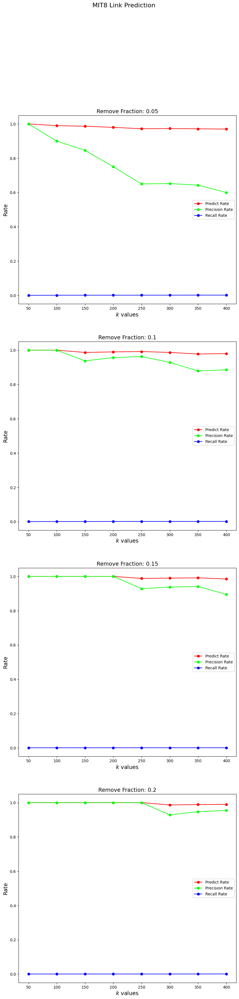

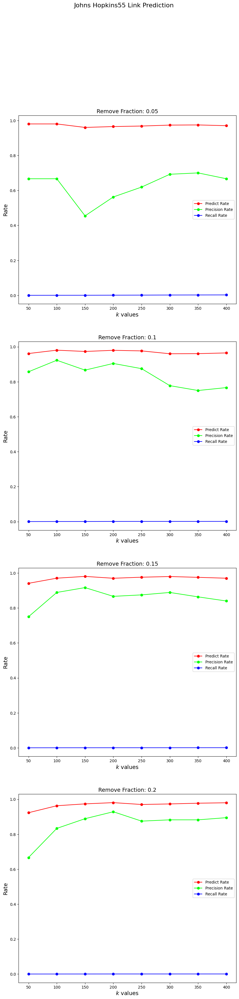

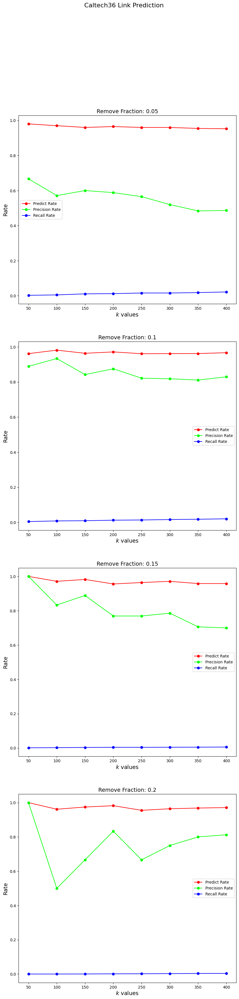

In [ ]:
#for graphName in GraphName:
fraction_removed_edges = [0.05, 0.1, 0.15, 0.2];
k_values = np.linspace(50, 400, 8).astype(int)
for graphName in GraphName:
  fig, axes = plt.subplots(len(fraction_removed_edges));
  fig.set_size_inches(10, 10*len(fraction_removed_edges));
  fig.suptitle(graphName+" Link Prediction",fontsize=16);
  df_LinkPred = dfLinkPredTotal[graphName];
  for i in range(len(fraction_removed_edges)):
    removeFract = fraction_removed_edges[i];
    ax = axes[i]

    df_Temp = df_LinkPred[(df_LinkPred['removed_fraction'] == removeFract)]
    #"predRate", "precisionRate", "recall"
    ax.plot(df_Temp['k'],df_Temp["predRate"], "-o",label = "Predict Rate",c=colorList[0])
    ax.plot(df_Temp['k'],df_Temp["precisionRate"], "-o", label="Precision Rate",c=colorList[1])
    ax.plot(df_Temp['k'],df_Temp["recall"], "-o", label = "Recall Rate",c=colorList[2])
    ax.legend(loc=0)
    ax.set_xlabel(r"$k$ values ",fontsize=14)
    ax.set_ylabel("Rate",fontsize=14);
    ax.set_title("Remove Fraction: "+str(removeFract),fontsize=14 );
  plt.show()



### Jaccard

In [ ]:
model = Jaccard(G, debug)
model.usename()

In [ ]:
#G = G_FB100_Dic["Caltech36"]
if 'dfLinkPredTotalJaccard' not in locals():
  dfLinkPredTotalJaccard = {}
#Load
for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_Jaccard_" + graphName +".csv";
  if graphName not in dfLinkPredTotalJaccard.keys():
    dfLinkPredTotalJaccard[graphName] = pd.read_csv(csvFileName);
#GraphName = [ 'Caltech36', 'MIT8', 'Johns Hopkins55']
TestGraphName = [ 'Caltech36']
#dfLinkPredTotalJaccard = {}
fraction_removed_edges = [0.05, 0.1, 0.15, 0.2];
#fraction_removed_edges = [0.1]
k_values = np.linspace(50, 400, 8).astype(int)
#k_values = [100]
for graphName in G_FB100_Dic.keys():
  G = G_FB100_Dic[graphName]
  if graphName not in dfLinkPredTotalJaccard.keys():
    debug = 0;
    model = Jaccard(G, debug)

    result = model.fit(fraction_removed_edges, k_values)
    df_LinkPred = pd.DataFrame(result,columns=["removed_fraction", "k", "intersectionLen", "predRate", "precisionRate", "recall"]);
    dfLinkPredTotalJaccard[graphName] = df_LinkPred;

for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_Jaccard_" + graphName +".csv"
  if graphName in dfLinkPredTotalJaccard.keys():
    df = dfLinkPredTotalJaccard[graphName];
    df.to_csv(csvFileName, index=False)

#### Save and Load

In [ ]:
#Save
for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_Jaccard_" + graphName +".csv"
  df = dfLinkPredTotalJaccard[graphName];
  df.to_csv(csvFileName, index=False)

In [ ]:
#Load
if 'dfLinkPredTotalJaccard' not in locals():
  dfLinkPredTotalJaccard = {}
LoadGraphName = [ 'Caltech36']
for graphName in LoadGraphName:
  csvFileName = my_path + "LinkPredict_Jaccard_" + graphName +".csv";
  #dfLinkPredTotalJaccard[graphName] = pd.read_csv(csvFileName);
  if graphName not in dfLinkPredTotalJaccard.keys():
    dfLinkPredTotalJaccard[graphName] = pd.read_csv(csvFileName);

#### Analyze the result

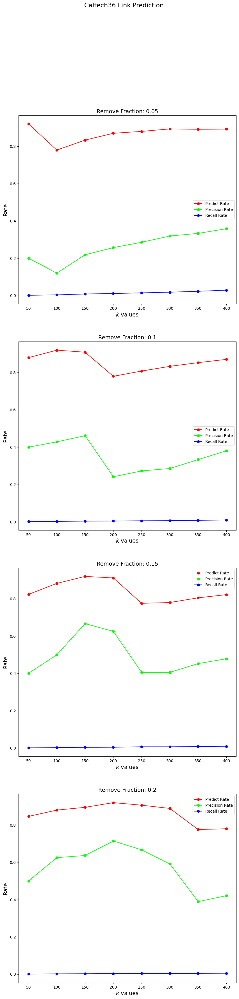

In [ ]:
TestGraphName = [ 'Caltech36']
for graphName in TestGraphName:
  fig, axes = plt.subplots(len(fraction_removed_edges));
  fig.set_size_inches(10, 10*len(fraction_removed_edges));
  fig.suptitle(graphName+" Link Prediction",fontsize=16);
  df_LinkPred = dfLinkPredTotal[graphName];
  for i in range(len(fraction_removed_edges)):
    removeFract = fraction_removed_edges[i];
    if len(fraction_removed_edges) == 1:
      ax = axes;
    else:
      ax = axes[i]

    df_Temp = df_LinkPred[(df_LinkPred['removed_fraction'] == removeFract)]
    #"predRate", "precisionRate", "recall"
    ax.plot(df_Temp['k'],df_Temp["predRate"], "-o",label = "Predict Rate",c=colorList[0])
    ax.plot(df_Temp['k'],df_Temp["precisionRate"], "-o", label="Precision Rate",c=colorList[1])
    ax.plot(df_Temp['k'],df_Temp["recall"], "-o", label = "Recall Rate",c=colorList[2])
    ax.legend(loc=0)
    ax.set_xlabel(r"$k$ values ",fontsize=14)
    ax.set_ylabel("Rate",fontsize=14);
    ax.set_title("Remove Fraction: "+str(removeFract),fontsize=14 );
  plt.show()


In [ ]:
print(result)

[(0.1, 50, 3, 0.54, 0.11538461538461539, 0.0018018018018018018), (0.1, 100, 4, 0.49, 0.07272727272727272, 0.0024024024024024023), (0.1, 150, 5, 0.4533333333333333, 0.05747126436781609, 0.003003003003003003), (0.1, 200, 6, 0.435, 0.05042016806722689, 0.0036036036036036037), (0.1, 250, 6, 0.396, 0.03821656050955414, 0.0036036036036036037), (0.1, 300, 7, 0.36333333333333334, 0.03535353535353535, 0.004204204204204204), (0.1, 350, 10, 0.3657142857142857, 0.04310344827586207, 0.006006006006006006), (0.1, 400, 15, 0.3625, 0.05555555555555555, 0.009009009009009009)]


### Adamic_Adar

In [ ]:
GraphName

['MIT8', 'Johns Hopkins55', 'Caltech36']

In [ ]:
for graphNa
GraphName.nodes()

In [ ]:
#G = G_FB100_Dic["Caltech36"]
if 'dfLinkPredTotalAdamicAdar' not in locals():
  dfLinkPredTotalAdamicAdar = {}
for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_Adamic_Adar_" + graphName +".csv";
  if graphName not in dfLinkPredTotalAdamicAdar.keys():
    dfLinkPredTotalAdamicAdar[graphName] = pd.read_csv(csvFileName);
#GraphName = [ 'Caltech36', 'MIT8', 'Johns Hopkins55']
TestGraphName = [ 'Caltech36']
fraction_removed_edges = [0.05, 0.1, 0.15, 0.2];
#fraction_removed_edges = [0.1]
k_values = np.linspace(50, 400, 8).astype(int)
#k_values = [100]
for graphName in GraphNameTotal:
  G = G_FB100_Dic[graphName]
  if graphName not in dfLinkPredTotalAdamicAdar.keys():
    debug = 0;
    model = Adamic_Adar(G, debug)
    result = model.fit(fraction_removed_edges, k_values)
    df_LinkPred = pd.DataFrame(result,columns=["removed_fraction", "k", "intersectionLen", "predRate", "precisionRate", "recall"]);
    dfLinkPredTotalAdamicAdar[graphName] = df_LinkPred;

for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_Adamic_Adar_" + graphName +".csv"
  if graphName in dfLinkPredTotalAdamicAdar.keys():
    df = dfLinkPredTotalAdamicAdar[graphName];
    df.to_csv(csvFileName, index=False)

#### Save and Load

In [ ]:
#Save
for graphName in GraphName:
  csvFileName = my_path + "LinkPredict_Adamic_Adar_" + graphName +".csv"
  df = dfLinkPredTotalAdamicAdar[graphName];
  df.to_csv(csvFileName, index=False)

In [ ]:
#Load
if 'dfLinkPredTotalAdamicAdar' not in locals():
  dfLinkPredTotalAdamicAdar = {}

LoadGraphName = ['Caltech36']
for graphName in LoadGraphName:
  csvFileName = my_path + "LinkPredict_Adamic_Adar_" + graphName +".csv";
  #dfLinkPredTotalAdamicAdar[graphName] = pd.read_csv(csvFileName);
  if graphName not in dfLinkPredTotalAdamicAdar.keys():
    dfLinkPredTotalAdamicAdar[graphName] = pd.read_csv(csvFileName);

#### Analyze the result

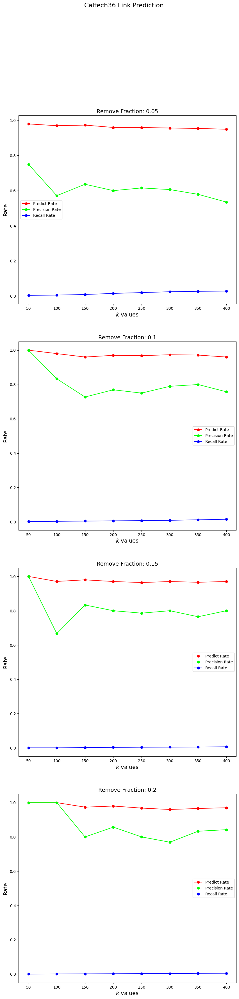

In [ ]:
TestGraphName = [ 'Caltech36']
for graphName in TestGraphName:
  fig, axes = plt.subplots(len(fraction_removed_edges));
  fig.set_size_inches(10, 10*len(fraction_removed_edges));
  fig.suptitle(graphName+" Link Prediction",fontsize=16);
  df_LinkPred = dfLinkPredTotal[graphName];
  for i in range(len(fraction_removed_edges)):
    removeFract = fraction_removed_edges[i];
    if len(fraction_removed_edges) == 1:
      ax = axes;
    else:
      ax = axes[i]

    df_Temp = df_LinkPred[(df_LinkPred['removed_fraction'] == removeFract)]
    #"predRate", "precisionRate", "recall"
    ax.plot(df_Temp['k'],df_Temp["predRate"], "-o",label = "Predict Rate", c=colorList[0])
    ax.plot(df_Temp['k'],df_Temp["precisionRate"], "-o", label="Precision Rate",c=colorList[1])
    ax.plot(df_Temp['k'],df_Temp["recall"], "-o", label = "Recall Rate",c=colorList[2])
    ax.legend(loc=0)
    ax.set_xlabel(r"$k$ values ",fontsize=14)
    ax.set_ylabel("Rate",fontsize=14);
    ax.set_title("Remove Fraction: "+str(removeFract),fontsize=14 );
  plt.show()


# Question 5

In [ ]:
#!pip install torch_geometric
#import torch_geometric.transforms as T
#from torch_geometric.nn import LabelPropagation

def fisher_yates(arr):
    # YOUR CODE HERE
    arraySize = len(arr)
    for i in range(arraySize - 1, 1, -1):
        shuffleIdx = np.random.uniform(0, i + 1, 1)
        shuffleIdx = int(shuffleIdx)
        temp = arr[i]
        arr[i] = arr[shuffleIdx]
        arr[shuffleIdx] = temp

    return arr

def lpa(G, attrList, X_label, max_iter=100):
    # YOUR CODE HERE
    """
    G: graph
    attr: attribute
    max iterator: default is 100
    X_lable: input the original X_label which include labeled and unlabeled.
            NaN: non label
             1: []
             0: []
    """
    print("Start LPA")
    nodeSize = len(G.nodes)
    attrLen = len(attrList)
    NodeToIndexDic = {}
    #Create a true falsue table to know which node is an unlabled node.
    #Create a table to compare node and index
    #Create a label array each row represent a type of label, ex dorm = [1 2 3 4]
    #
    UnLabelMask = np.zeros(nodeSize)
    index = 0
    for node in G.nodes():
        if np.isnan(X_label[index]):
            UnLabelMask[index] = True
        NodeToIndexDic[node] = index
        index += 1
    print("Node to Index Table:",NodeToIndexDic)
    #print("Unlabel mask:",UnLabelMask)
    #create N dimension label based on the number of types of label
    LabelToIdxTab = {}
    index = 0
    for attr in attrList:
        LabelToIdxTab[attr] = index
        index += 1
    print("Label To Index:", LabelToIdxTab)
    #initialize the label
    label = np.zeros((attrLen,nodeSize))
    for i in range(nodeSize):
      if UnLabelMask[i] == False:
        label[LabelToIdxTab[X_label[i]],i] = 1

    #print(label)

    #calculate the weight
    for node in G.nodes():
      numberOfNeighbor = len(G[node])
      if numberOfNeighbor == 0:
        G.nodes[node]["weight"] = 0;
      else:
        G.nodes[node]["weight"] = 1/numberOfNeighbor
    print("Node Weight:", list([G.nodes[node]["weight"] for node in G.nodes()]))

    labelChange = 1
    i = 0
    while i < max_iter and labelChange != 0:
        labelChange = 1
        nodeList = list(G.nodes())

        fisher_yates(nodeList) #randomize the nodes order to walk
        #print(nodeList)#check if the order of nodes are randomized

        #Search all node

        #print("iteration[%d]" %(i))
        for j in nodeList:

            #calculate the edge weight!
            # W_node_N = 1 / N_num_of_neighbors_node
            #Step 1. Make sure the node is unlabel
            #Step 2. If yes ==> Collect all the label from neighbor and calculate the value
            #                   Sum (Weigting * labeled_value)
            nodeIndex = NodeToIndexDic[j]
            #print("Node:",j,"Index:",nodeIndex)
            if UnLabelMask[nodeIndex] == True:
                label[:,nodeIndex] = 0
                #print("Original Unlabel Node[%d]" %(nodeIndex), label[:,nodeIndex])
                for neighbor in G[j]:
                    neighborIndex = NodeToIndexDic[neighbor]
                    label[:,nodeIndex] = label[:,nodeIndex] + G.nodes[neighbor]["weight"] * label[:,neighborIndex]
                #print("After Unlabel Node[%d]" %(nodeIndex), label[:,nodeIndex])

        #print("[%d]:" %(i), label)
        i += 1

    #After coumputing, we set the find the maximum value as label
    maxIndex = []
    maxIndex = np.argmax(label,axis = 0)
    IdexToLabel = list(LabelToIdxTab.keys())
    label_final = list([ IdexToLabel[idx] for idx in maxIndex])

    #print("Label:",label)

    return label_final

In [ ]:
remove = [node for node,attrValue in nx.get_node_attributes(G, 'major_index').items() if attrValue==0]

print(remove)
G_Copy = G.copy()
G_Copy.remove_nodes_from(remove)

print(G_Copy.nodes())

['6', '7', '8', '39', '60', '67', '74', '83', '97', '105', '113', '125', '146', '158', '165', '171', '172', '183', '189', '193', '206', '220', '233', '236', '263', '270', '271', '287', '296', '305', '316', '317', '320', '323', '337', '357', '387', '393', '400', '402', '409', '417', '424', '445', '463', '471', '478', '488', '490', '500', '504', '507', '522', '532', '539', '552', '564', '565', '605', '626', '628', '632', '638', '639', '672', '673', '688', '692', '700', '707', '715', '726', '728', '730', '732', '748', '749']
['0', '1', '2', '3', '4', '5', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '61', '62', '63', '64', '65', '66', '68', '69', '70', '71', '72', '73', '75', '76', '77', '78', '79', '80', '81', '82', '84', '85', '86', '87'

In [ ]:
print(GraphNameTotal)
print(G_FB100_Dic.keys())
showTotalGraphSize()

['Caltech36', 'MIT8', 'Johns Hopkins55', 'NYU9', 'Georgetown15', 'Princeton12', 'Reed98', 'Stanford3', 'Dartmouth6', 'Emory27', 'Cal65', 'Harvard1', 'Maryland58', 'Williams40', 'Northeastern19', 'USC35', 'Mich67', 'Brandeis99', 'Texas80', 'UIllinois20', 'Wisconsin87', 'BC17', 'Simmons81', 'American75', 'Penn94', 'Tennessee95', 'Auburn71', 'UC61', 'Hamilton46', 'Tulane29', 'Haverford76', 'UC33', 'UMass92', 'Amherst41', 'WashU32', 'Oklahoma97', 'Villanova62', 'UNC28', 'BU10', 'Wesleyan43', 'Trinity100', 'Vermont70', 'Virginia63', 'Northwestern25', 'UGA50', 'Michigan23', 'Cornell5', 'Bucknell39', 'UCSD34', 'Wellesley22', 'Mississippi66', 'Carnegie49', 'Brown11', 'Baylor93', 'Maine59', 'USFCA72', 'Berkeley13', 'Rochester38', 'UCSC68', 'Yale4', 'Columbia2', 'MU78', 'Notre Dame57', 'MSU24', 'Vanderbilt48', 'UChicago30', 'UCSB37', 'Rutgers89', 'Oberlin44', 'Howard90', 'FSU53', 'Smith60', 'Lehigh96', 'Texas84', 'UCF52', 'UC64', 'Santa74', 'Syracuse56', 'Colgate88', 'Duke14', 'Pepperdine86', 'U

In [ ]:
TestGraph = ['Caltech36', 'MIT8', 'Johns Hopkins55']
#TestGraph = ['Caltech36']
graphList = pd.unique(dfLPA["Graph"]);
existGraph = set(graphList).intersection(TestGraph)
for graph in existGraph:
  TestGraph.remove(graph);
print(TestGraph)

['MIT8', 'Johns Hopkins55']


In [ ]:
showTotalGraphSize()

Caltech36 : 769
MIT8 : 6440
Johns Hopkins55 : 5180
NYU9 : 21679
Georgetown15 : 9414
Princeton12 : 6596
Reed98 : 962
Stanford3 : 11621
Dartmouth6 : 7694
Emory27 : 7460
Cal65 : 11247
Harvard1 : 15126
Maryland58 : 20871
Williams40 : 2790
Northeastern19 : 13882
USC35 : 17444


In [ ]:
import random
if 'dfLPA' not in locals():
  dfLPA = pd.DataFrame(columns=["Graph","Attribute","FracRemoved","SuccessRate"])



#['student_fac', 'gender', 'major_index', 'second_major', 'dorm', 'year', 'high_school']
attributes = [ 'major_index', 'dorm', 'gender', 'year']
#attributes = [ 'major_index']
TestGraph = ['Caltech36', 'MIT8', 'Johns Hopkins55',"Reed98","Princeton12"]
#TestGraph = ['Princeton12']
graphList = pd.unique(dfLPA["Graph"]);
existGraph = set(graphList).intersection(TestGraph)
for graph in existGraph:
  TestGraph.remove(graph);
# choose the graph
for graphName in TestGraph:
    print("==============Graph: ",graphName,"==============")
    G = G_FB100_Dic[graphName]
# choose the attribute to do label propagation

    for attr in attributes:
# split the data to label and unlabel, choos the unlabel rate

        G_Copy = G.copy()
        #Remove invalid value
        remove = [node for node,attrValue in nx.get_node_attributes(G, attr).items() if attrValue==0]
        G_Copy.remove_nodes_from(remove)
        attrArray = list(nx.get_node_attributes(G_Copy, attr).values())
        nodeLength = len(G_Copy.nodes())
        assert nodeLength == len(attrArray)
        uniqueList = np.unique(attrArray)
        attrArray_copy = list.copy(attrArray)
        print("[%s] Len:%d" %(attr,len(uniqueList)),"Attribute Labels:", uniqueList)
        for unLabelRate in np.arange(0.1, 0.4, 0.1):
          print("unlabel rate:%f" %(unLabelRate));
          #mask part of node
          #unLabelRate = 0.2
          random_boolean_list = random.choices(
              [True, False],
              k=nodeLength,
              weights=[100*(1-unLabelRate), 100*unLabelRate]
          )
          random_boolean_list = np.array(random_boolean_list)
          #print(random_boolean_list)
          for i in range(len(random_boolean_list)):
            if random_boolean_list[i] == False:
              attrArray_copy[i] = np.nan

          #attrArray[index for index in range(len(random_boolean_list)): if random_boolean_list[index] == False] = np.nan
          #print(attrArray_copy)

  # Run LPA
          X_pred = lpa(G_Copy, uniqueList, attrArray_copy)

  #Compare the precision (Just care about unlabel node)
          Total_Count = 0
          TrueCount = 0
          FalseCount = 0
          for index in range(len(random_boolean_list)):
            if random_boolean_list[index] == False:
              Total_Count += 1
              if (X_pred[index] == attrArray[index]):
                TrueCount += 1
              else:
                FalseCount += 1
          #["Graph","Attribute","FracRemoved","SuccessRate"]
          #print("Graph:%s Attr:%s Success Fraction Removed:%f Rate:%f Failed Rate:%f" %(graphName, attr, unLabelRate, TrueCount/Total_Count, FalseCount/Total_Count))
          newData = [graphName, attr, unLabelRate, TrueCount/Total_Count]
          dfLPA.loc[len(dfLPA)] = newData

#Save
csvFileName = my_path + "LPA_All"+".csv"
df = dfLPA;
df.to_csv(csvFileName, index=False)
#Maybe plot the graph compare the original one

==============Graph:  Princeton12 ==============
[major_index] Len:40 Attribute Labels: [289 290 291 292 293 294 295 296 297 298 299 300 301 302 303 304 305 306
 307 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322 323 324
 325 326 328 329]
unlabel rate:0.100000
Start LPA
Node to Index Table: {'0': 0, '1': 1, '2': 2, '4': 3, '5': 4, '6': 5, '7': 6, '8': 7, '12': 8, '13': 9, '16': 10, '19': 11, '21': 12, '22': 13, '23': 14, '24': 15, '28': 16, '29': 17, '30': 18, '32': 19, '33': 20, '34': 21, '35': 22, '36': 23, '37': 24, '38': 25, '41': 26, '42': 27, '43': 28, '44': 29, '45': 30, '46': 31, '48': 32, '49': 33, '50': 34, '52': 35, '53': 36, '54': 37, '55': 38, '56': 39, '57': 40, '58': 41, '59': 42, '61': 43, '62': 44, '63': 45, '65': 46, '66': 47, '67': 48, '68': 49, '69': 50, '70': 51, '71': 52, '72': 53, '73': 54, '74': 55, '75': 56, '77': 57, '78': 58, '81': 59, '82': 60, '83': 61, '84': 62, '85': 63, '87': 64, '89': 65, '90': 66, '91': 67, '92': 68, '93': 69, '94': 70, '9

In [ ]:
np.arange(0.1, 0.4, 0.1)

array([0.1, 0.2, 0.3, 0.4])

In [ ]:
pd.unique(dfLPA['Graph'])

array(['Caltech36', 'MIT8', 'Johns Hopkins55', 'Reed98', 'Princeton12'],
      dtype=object)

In [ ]:
attrList = list(pd.unique(dfLPA['Attribute']))
print(attrList)

['major_index', 'dorm', 'gender', 'year']


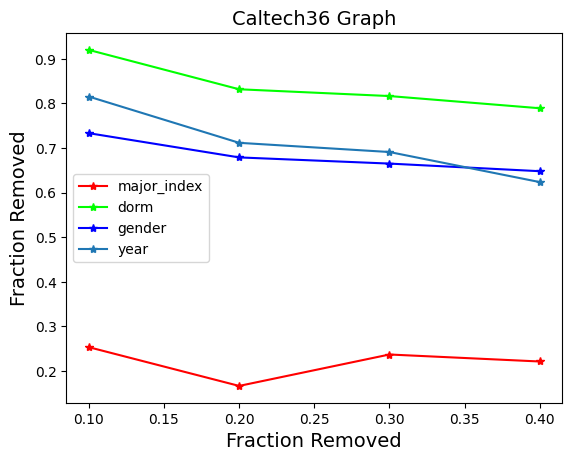

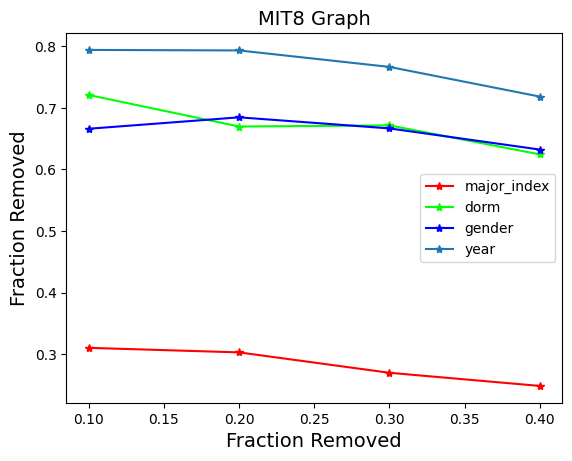

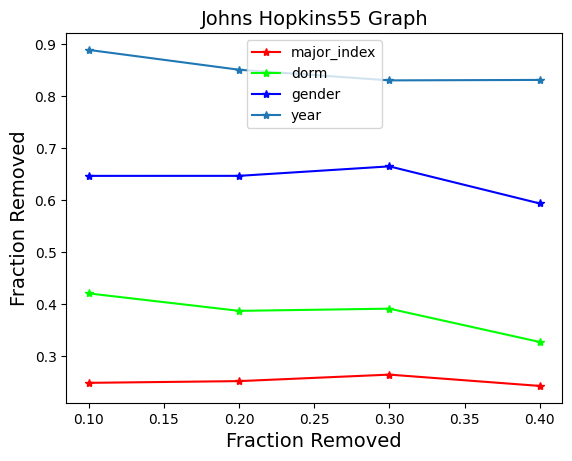

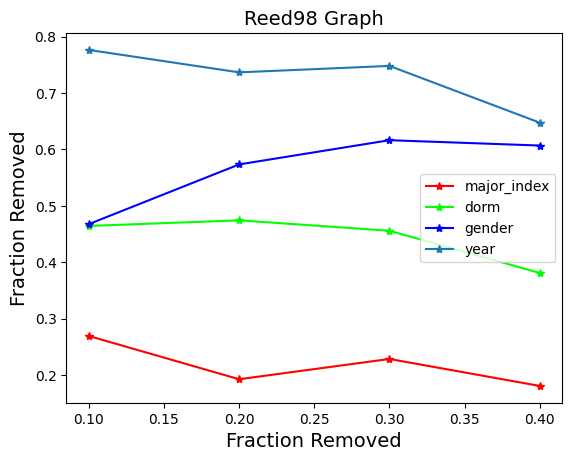

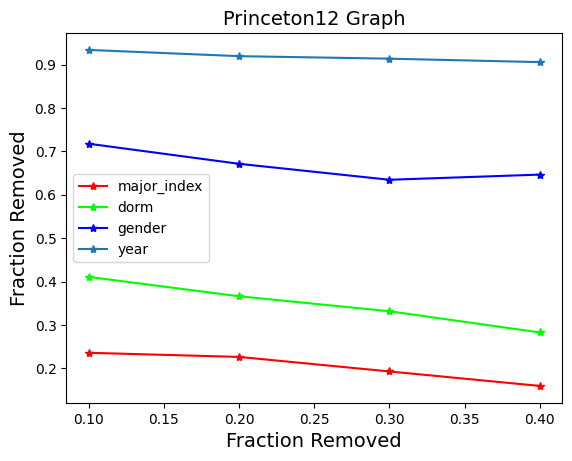

In [ ]:
attrList = list(pd.unique(dfLPA['Attribute']))
graphList = list(pd.unique(dfLPA['Graph']))

for graphName in graphList:
  fig = plt.figure();
  dfLAP_graph = dfLPA[dfLPA["Graph"]==graphName];
  i = 0;
  for attr in attrList:
    df = dfLAP_graph[ dfLAP_graph["Attribute"]==attr ];
    plt.plot(df['FracRemoved'],df["SuccessRate"],'-*',label=attr,c=colorList[i]);
    i += 1;
  plt.legend()
  plt.xlabel(r"Fraction Removed",fontsize=14);
  plt.ylabel(r"Fraction Removed",fontsize=14);
  plt.title(graphName+r" Graph",fontsize=14);

In [ ]:
from matplotlib import pyplot as plt
dfLPA['FracRemoved'].plot(kind='hist', bins=20, title='FracRemoved')
plt.gca().spines[['top', 'right',]].set_visible(False)

#### Save and Load

In [ ]:
#Save
csvFileName = my_path + "LPA_All"+".csv"
df = dfLPA;
df.to_csv(csvFileName, index=False)

In [ ]:
#Load
if 'dfLPA' not in locals():
  dfLPA = {}

csvFileName = my_path + "LPA_All"+".csv"
dfLPA = pd.read_csv(csvFileName);

#### some test code...

In [ ]:
G = G_FB100_Dic[graphName]
for node in G.nodes():
  #print(G[node])
  n = len(G[node])
  print(n)
  break;

nodeList = list(G.nodes())
print(G.nodes(), type(nodeList[0]))
for node in G.nodes():
  for neighbor in G[node]:
    if node < neighbor:
      print("Neighbor %s < node %s" %(node,neighbor))
  break;


In [ ]:
G = G_FB100_Dic[graphName]
nodeList = list(G.nodes())
attributes = [ 'major_index', 'dorm', 'gender', 'year']
#for attr in G.nodes[nodeList[0]].keys():
n = 0
for graphName in GraphName:
    print("Grapha:",graphName)
    for attr in attributes:
        print(attr)
        attrArray = list(nx.get_node_attributes(G, attr).values())

        uniqueList = np.unique(attrArray)
        print(uniqueList)
        if len(uniqueList) < 1000:
            for uniq in np.unique(attrArray):
                print(uniq,"num:%d" %(np.count_nonzero(attrArray == uniq)))
    n += 1
    if n > 3:
        break;
#color = nx.get_node_attributes(G, "color")

Grapha: MIT8
major_index
[  0 190 192 194 195 196 197 198 199 200 201 202 204 205 206 207 208 209
 211 212 213 217 220 221 222 223 224 226 227 228 229]
0 num:77
190 num:24
192 num:16
194 num:14
195 num:1
196 num:20
197 num:4
198 num:4
199 num:86
200 num:8
201 num:36
202 num:51
204 num:17
205 num:49
206 num:3
207 num:10
208 num:85
209 num:24
211 num:4
212 num:22
213 num:1
217 num:3
220 num:3
221 num:4
222 num:44
223 num:64
224 num:2
226 num:3
227 num:1
228 num:88
229 num:1
dorm
[  0 165 166 167 168 169 170 171 172]
0 num:172
165 num:44
166 num:70
167 num:63
168 num:76
169 num:99
170 num:87
171 num:67
172 num:91
gender
[0 1 2]
0 num:66
1 num:228
2 num:475
year
[   0 1968 1976 1979 1984 1993 1996 1999 2001 2002 2003 2004 2005 2006
 2007 2008 2009 2010]
0 num:114
1968 num:1
1976 num:1
1979 num:1
1984 num:1
1993 num:1
1996 num:1
1999 num:1
2001 num:3
2002 num:7
2003 num:10
2004 num:39
2005 num:105
2006 num:153
2007 num:133
2008 num:173
2009 num:23
2010 num:2
Grapha: Johns Hopkins55
major_in

In [ ]:
arr = [[0, 0, 0, 0, 1],[ 2 ,1,1,1,1]]
arr0 = np.zeros((7,3))
print(arr0)
arr2 = np.argmax(arr,axis = 0)
print(arr2)

arrTF = [True, False, True, False]
arr3 = [1, 2, 3, 4]
#np.where(arrTF is True, arr3 + 30, arr3)
#print(arr3)

[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
[1 1 1 1 0]


In [ ]:
import random
random_boolean_list = random.choices(
    [True, False],
    k=3,
    weights=[75, 25]
)
print(random_boolean_list)

In [ ]:
import random
random_boolean_list = random.choices(
    [True, False],
    k=3,
    weights=[75, 25]
)
print(random_boolean_list)

[True, False, True]


# Question 6

## Louvain Community Detection

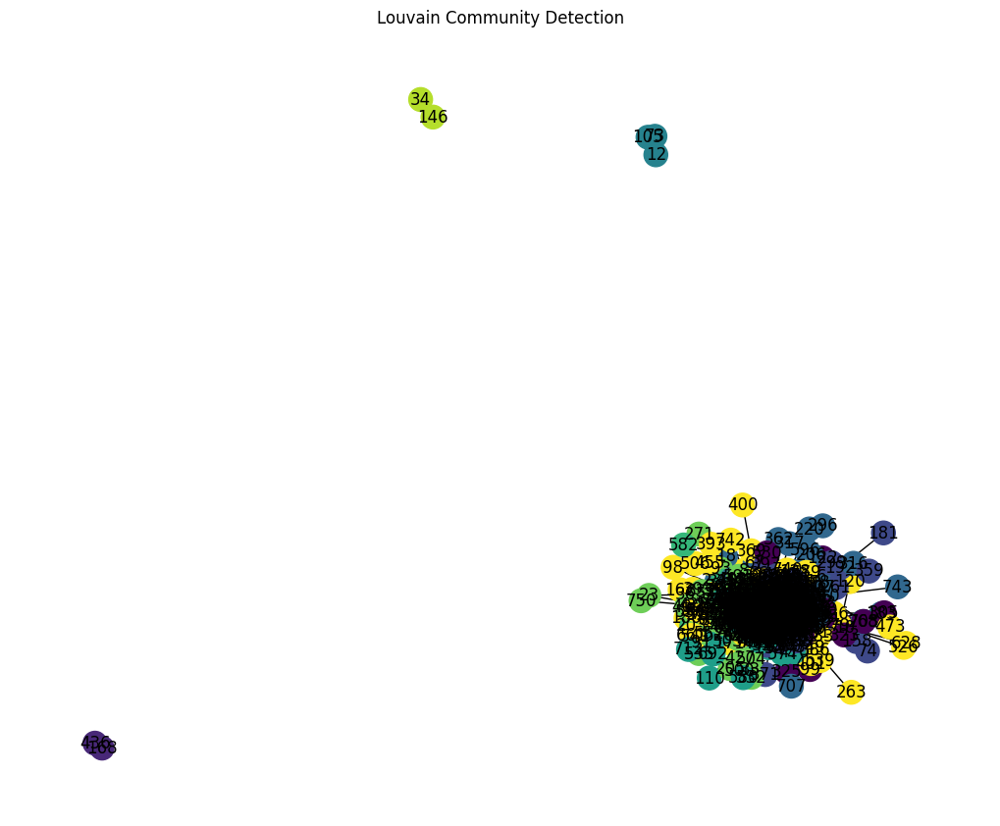

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import community  # Python-Louvain library
import community.community_louvain
import matplotlib.cm as cm
import matplotlib.pyplot as plt

# Load the FB100 dataset
# You may need to replace 'filename' with the actual path to your dataset file
G = G_FB100_Dic["Caltech36"]

# Select a few universities for analysis
#universities = ['0', '107', '348', '398']  # Replace with university codes from your dataset

# Create a subgraph with nodes from the selected universities
# = G.subgraph(sum([list(G.neighbors(u)) + [u] for u in universities], []))

# Apply the Louvain community detection algorithm
partition = community.community_louvain.best_partition(G)

# Visualize the communities
pos = nx.spring_layout(G)
plt.figure(figsize=(10, 8))
colors = [partition[node] for node in G.nodes]
nx.draw(G, pos, node_color=colors, with_labels=True, cmap=plt.cm.get_cmap("viridis"))
plt.title("Louvain Community Detection")
plt.show()

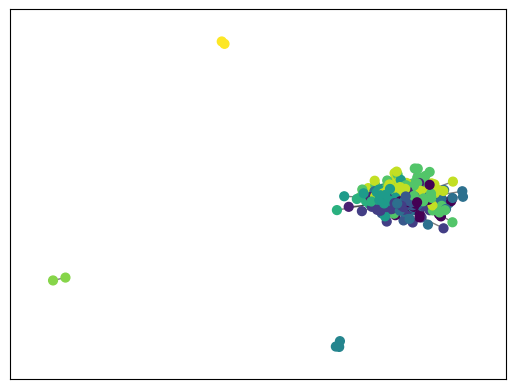

In [ ]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt

# draw the graph
pos = nx.spring_layout(G)
# color the nodes according to their partition
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx_nodes(G, pos, partition.keys(), node_size=40, cmap=cmap, node_color=list(partition.values()))
nx.draw_networkx_edges(G, pos, alpha=0.5)

### Analyze Outcome

In [ ]:
import matplotlib.colors as mcolors
print(partition.keys())
print(list(set(partition.values())))
print(G.nodes['0'].keys())
print(G.nodes['0'].values())
df_graph = pd.DataFrame();
attrList = list(G.nodes['0'].keys())
nodeList = list(G.nodes());
df_graph['node'] = nodeList
for attr in attrList:
  print(attr, " : ",nx.get_node_attributes(G, attr).values())
  df_graph[attr] = list(nx.get_node_attributes(G, attr).values())
def groupLabel(row, groupPartition):
  return groupPartition[row['node']];
df_graph['group_label'] = df_graph.apply(lambda x: groupLabel(x,partition), axis=1)


def colorGroupLabel(row):
  colorList = list(mcolors.TABLEAU_COLORS.values());
  colorList = colorList + ['k']
  return colorList[row['group_label']];
df_graph['group_color'] = df_graph.apply(lambda row: colorGroupLabel(row), axis=1);

dict_keys(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99', '100', '101', '102', '103', '104', '105', '106', '107', '108', '109', '110', '111', '112', '113', '114', '115', '116', '117', '118', '119', '120', '121', '122', '123', '124', '125', '126', '127', '128', '129', '130', '131', '132', '133', '134', '135', '136', '137', '138', '139', '140', '141', '142', '143', '144', '145', '146', '147', '148', '149', '150', '151', '152', '153', '154', '155', '156', 

In [ ]:
df_graph.head(5)
#df_graph['group_label'].unique()

,node,student_fac,gender,major_index,second_major,dorm,year,high_school,group_label,group_color
0,0,1,1,199,0,169,2008,3387,0,#1f77b4
1,1,1,1,199,0,165,2006,3172,10,k
2,2,1,2,201,0,171,2008,9773,5,#8c564b
3,3,2,2,208,210,172,2005,50578,10,k
4,4,1,2,202,0,169,2008,11880,0,#1f77b4


In [ ]:
import matplotlib.colors as mcolors
print(mcolors.TABLEAU_COLORS)
print(mcolors.TABLEAU_COLORS.values())
colorList = mcolors.TABLEAU_COLORS.values()
print(len(colorList))
type(mcolors.TABLEAU_COLORS)
#colorTable = [color for color in mcolors.TABLEAU_COLORS];


{'tab:blue': '#1f77b4', 'tab:orange': '#ff7f0e', 'tab:green': '#2ca02c', 'tab:red': '#d62728', 'tab:purple': '#9467bd', 'tab:brown': '#8c564b', 'tab:pink': '#e377c2', 'tab:gray': '#7f7f7f', 'tab:olive': '#bcbd22', 'tab:cyan': '#17becf'}
dict_values(['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf'])
10


dict

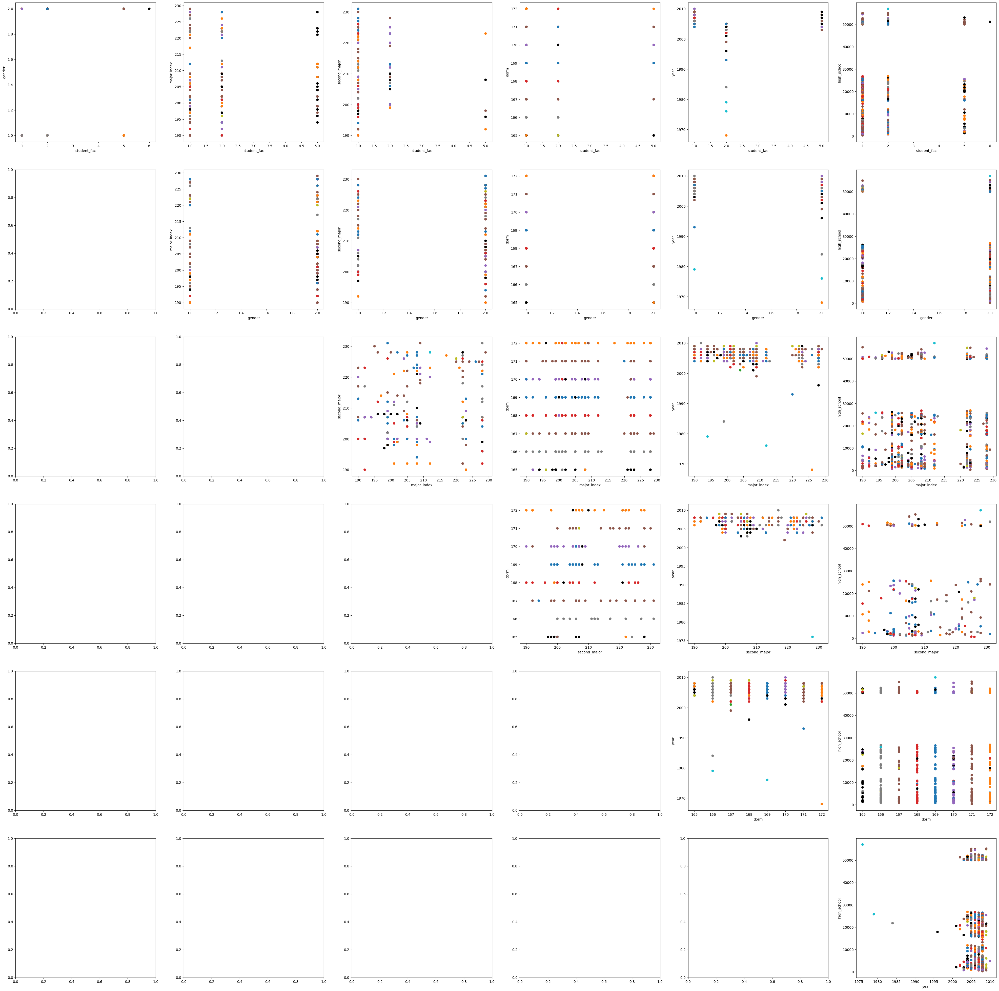

In [ ]:
nodeList = list(G.nodes());
attrList = list(G.nodes[nodeList[0]].keys())
fig, axes = plt.subplots(len(attrList)-1,len(attrList)-1);
fig.set_size_inches(50, 50)
# Compare the group label with the two selected features in order to know which feature will influence the community more
for i in range(len(attrList)-1):
  for j in range(i+1,len(attrList)):
    ax = axes[i][j-1];

    df = pd.concat([df_graph[attrList[i]], df_graph[attrList[j]], df_graph['group_color'] ], axis=1,join='outer')
    df = df[(df[attrList[i]] != 0) & (df[attrList[j]] != 0)];
    ax.scatter(df[attrList[i]],df[attrList[j]],c=df['group_color']);
    ax.set_xlabel(attrList[i]);
    ax.set_ylabel(attrList[j]);



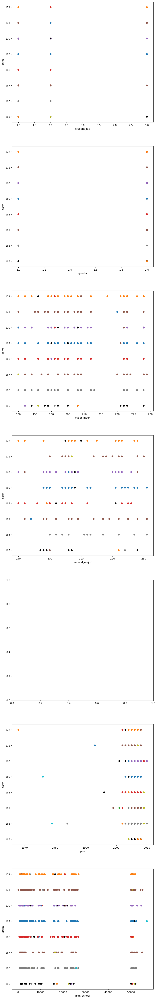

In [ ]:
nodeList = list(G.nodes());
attrList = list(G.nodes[nodeList[0]].keys())
majorAttr = "dorm";
fig, axes = plt.subplots(len(attrList));
fig.set_size_inches(10, 10*len(attrList))
# Compare the group label with the two selected features in order to know which feature will influence the community more
for i in range(len(attrList)):
    if attrList[i] != majorAttr:
      ax = axes[i];
      df = pd.concat([df_graph[attrList[i]], df_graph[majorAttr], df_graph['group_color'] ], axis=1,join='outer')
      df = df[(df[attrList[i]] != 0) & (df[majorAttr] != 0)];
      ax.scatter(df[attrList[i]],df[majorAttr],c=df['group_color']);
      ax.set_xlabel(attrList[i]);
      ax.set_ylabel(majorAttr);

In [ ]:
dfAllAttrNum.keys()

dict_keys([])

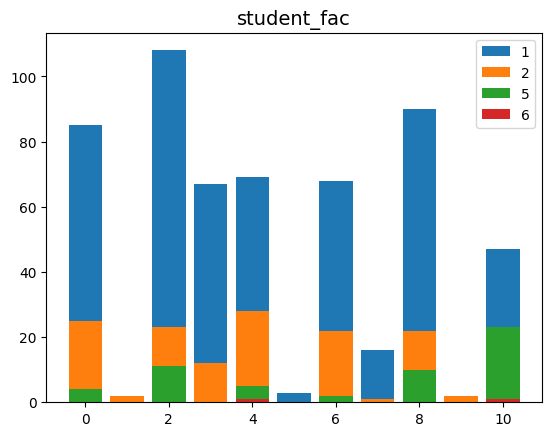

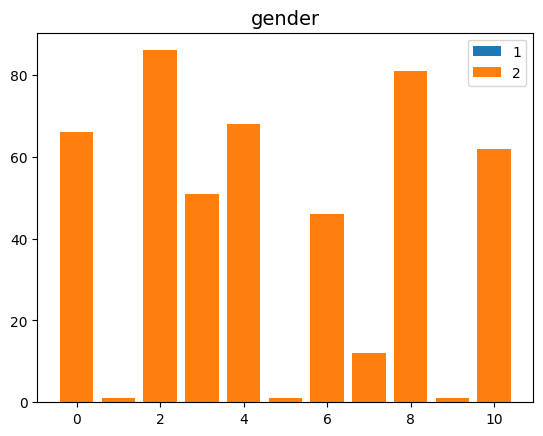

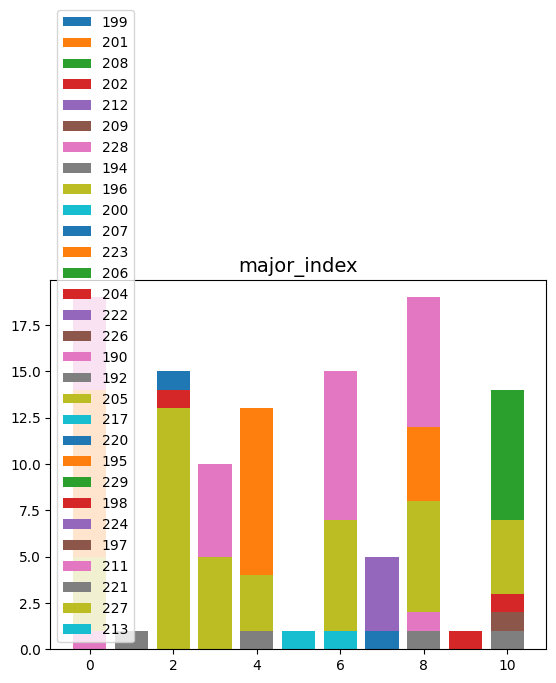

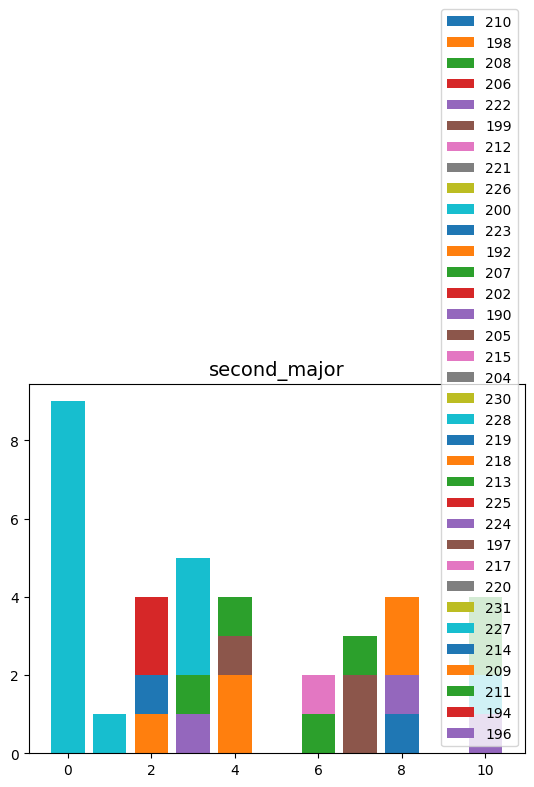

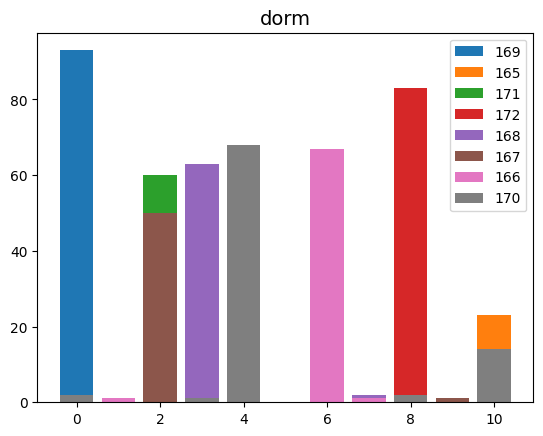

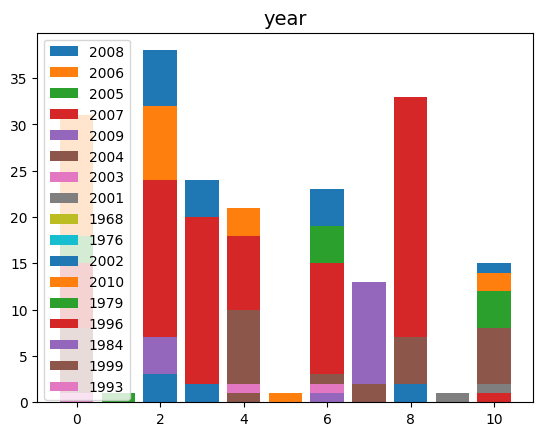

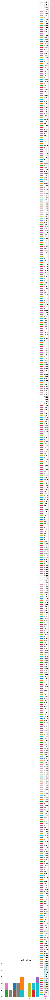

In [ ]:
analyzeGraph = ["Caltech36", ]
for graphName in analyzeGraph:
  G = G_FB100_Dic[graphName];
  nodeList = list(G.nodes());
  attrList = list(G.nodes[nodeList[0]].keys())
  groupList = list(pd.unique(df_graph['group_label']))
  majorAttr = "dorm";
  #fig, axes = plt.subplots(len(attrList));
  #fig.set_size_inches(10, 10*len(attrList))
  # Compare the group label with the two selected features in order to know which feature will influence the community more
  dfAllAttrNum={}
  basicInfo = ["Graph","Attribute","Group"]
  for group in groupList:
    df_subgroup = df_graph[df_graph['group_label']== group];
    for attr in attrList:
      attributeType = list(pd.unique(df_graph[attr]))
      if 0 in attributeType:
        attributeType.remove(0)
      if attr not in dfAllAttrNum.keys():
        df = pd.DataFrame(columns=basicInfo + attributeType)
        dfAllAttrNum[attr] = df;
      else:
        df = dfAllAttrNum[attr];
      newRow = [graphName, attr, group];
      for attrtype in attributeType:
        N = len(df_subgroup[df_subgroup[attr] == attrtype]);
        newRow.append(N);
      #print(newRow)
      df.loc[len(df)] = newRow;
  for attr in attrList:
    df = dfAllAttrNum[attr];
    attributeType = list(pd.unique(df_graph[attr]))
    if 0 in attributeType:
        attributeType.remove(0)
    fig = plt.figure()
    for attrType in attributeType:
      plt.bar(df['Group'],df[attrType],label = attrType);
    plt.title(attr, fontsize = 14)
    plt.legend()
    plt.show()



## Infomap

In [ ]:
!pip install infomap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 263.1/263.1 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for infomap: filename=infomap-2.7.1-cp310-cp310-linux_x86_64.whl size=7690300 sha256=530e4418f86fcee0df952da16f75a0fbda21f22c1d81c6e322923c908c2b7c3c
  Stored in directory: /root/.cache/pip/wheels/e4/01/53/fd7c62079098140cd582b999592b4592c0dad7300cac32b6e1
Successfully built infomap


In [ ]:
!pip install infomap
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import infomap
from pprint import pprint

def findCommunities(G):
    """
    Partition network with the Infomap algorithm.
    Annotates nodes with 'community' id and return number of communities found.
    """
    infomapWrapper = infomap.Infomap("--two-level --silent")

    print("Building Infomap network from a NetworkX graph...")
    mapping = infomapWrapper.add_networkx_graph(G)
    #for e in G.edges():
    #    infomapWrapper.addLink(*e)

    print("Find communities with Infomap...")
    infomapWrapper.run();
    for node in infomapWrapper.nodes:
      print(node.node_id, node.module_id, node.flow, mapping[node.node_id])
      #print(type(mapping[node.node_id]))
      break;

    tree = infomapWrapper.get_tree()

    print("Found %d modules with codelength: %f" % (infomapWrapper.num_top_modules, infomapWrapper.codelength))

    communities = {}
    for node in infomapWrapper.nodes:
      #obj_vars = vars(node)
      #pprint(obj_vars)
      #print(node);
      #print("Child Idx: ",node.child_index,"Module Id: ",node.module_id)
      #communities[node.child_index] = node.module_id
      communities[mapping[node.node_id]] = node.module_id
      #print("node: ", mapping[node.node_id],"Module Id: ",node.module_id)

    nx.set_node_attributes(G,communities, name = 'community')
    return infomapWrapper.num_top_modules


def drawNetwork(G):
    # position map
    pos = nx.spring_layout(G)
    for key in pos.keys():
      pos[key] = pos[key]*10;
    print("Pos:",pos)
    # community ids
    communities = [v for k,v in nx.get_node_attributes(G, 'community').items()]
    #communities = nx.get_node_attributes(G, 'community');
    print("Communities:",communities);
    numCommunities = max(communities) + 1
    #numCommunities = max(communities.values()) + 1
    print(numCommunities)
    # color map from http://colorbrewer2.org/
    cmapLight = colors.ListedColormap(['#a6cee3', '#b2df8a', '#fb9a99', '#fdbf6f', '#cab2d6'], 'indexed', numCommunities)
    cmapDark = colors.ListedColormap(['#1f78b4', '#33a02c', '#e31a1c', '#ff7f00', '#6a3d9a'], 'indexed', numCommunities)

    fig = plt.figure(figsize=(30,30))
    ax = plt.axes()
    ax.set_xlim(-2, 2)
    ax.set_ylim(-2, 2)
    # Draw edges
    nx.draw_networkx_edges(G, pos)

    # Draw nodes
    nodeCollection = nx.draw_networkx_nodes(G,
        pos = pos,
        node_color = communities,
        cmap = cmapLight,
        #ax = ax
    )
    # Set node border color to the darker shade
    darkColors = [cmapDark(v) for v in communities]
    nodeCollection.set_edgecolor(darkColors)

    # Draw node labels
    for n in G.nodes():
        plt.annotate(n,
            xy = pos[n],
            textcoords = 'offset points',
            horizontalalignment = 'center',
            verticalalignment = 'center',
            xytext = [0, 0],
            color = cmapDark(communities[int(n)])
        )

    plt.axis('off')
    # plt.savefig("karate.png")
    plt.show()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 263.1/263.1 kB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for infomap: filename=infomap-2.7.1-cp310-cp310-linux_x86_64.whl size=7690297 sha256=0c1225a349ff23130f2273c3bc4e63b8bf3259b2416a23031fb45ecb91397bc1
  Stored in directory: /root/.cache/pip/wheels/e4/01/53/fd7c62079098140cd582b999592b4592c0dad7300cac32b6e1
Successfully built infomap


In [ ]:
drawNetwork(G)

Building Infomap network from a NetworkX graph...
Find communities with Infomap...
708 1 0.0074447646493755884 708
Found 15 modules with codelength: 8.877157
Pos: {'0': array([-0.01536729, -0.14749187]), '1': array([0.00393699, 0.23902738]), '2': array([-0.37831798,  0.50149746]), '3': array([0.50610494, 0.28286545]), '4': array([ 0.00222657, -0.27157972]), '5': array([-0.13280785, -0.38944703]), '6': array([ 0.43226335, -0.92197679]), '7': array([-0.0340574 ,  0.08136094]), '8': array([0.32745879, 0.82446635]), '9': array([-0.03801435,  0.35530463]), '10': array([ 0.91676295, -0.48019093]), '11': array([ 0.18937413, -0.12249117]), '12': array([-9.76335645, -0.63606039]), '13': array([0.27051859, 0.21634825]), '14': array([-0.45532819, -0.20230623]), '15': array([-0.29779477, -0.15395837]), '16': array([-0.74927479,  0.12340873]), '17': array([ 0.263508  , -0.03351208]), '18': array([1.27373636, 0.4333571 ]), '19': array([ 0.20517502, -0.45272198]), '20': array([0.19716667, 0.12810549]

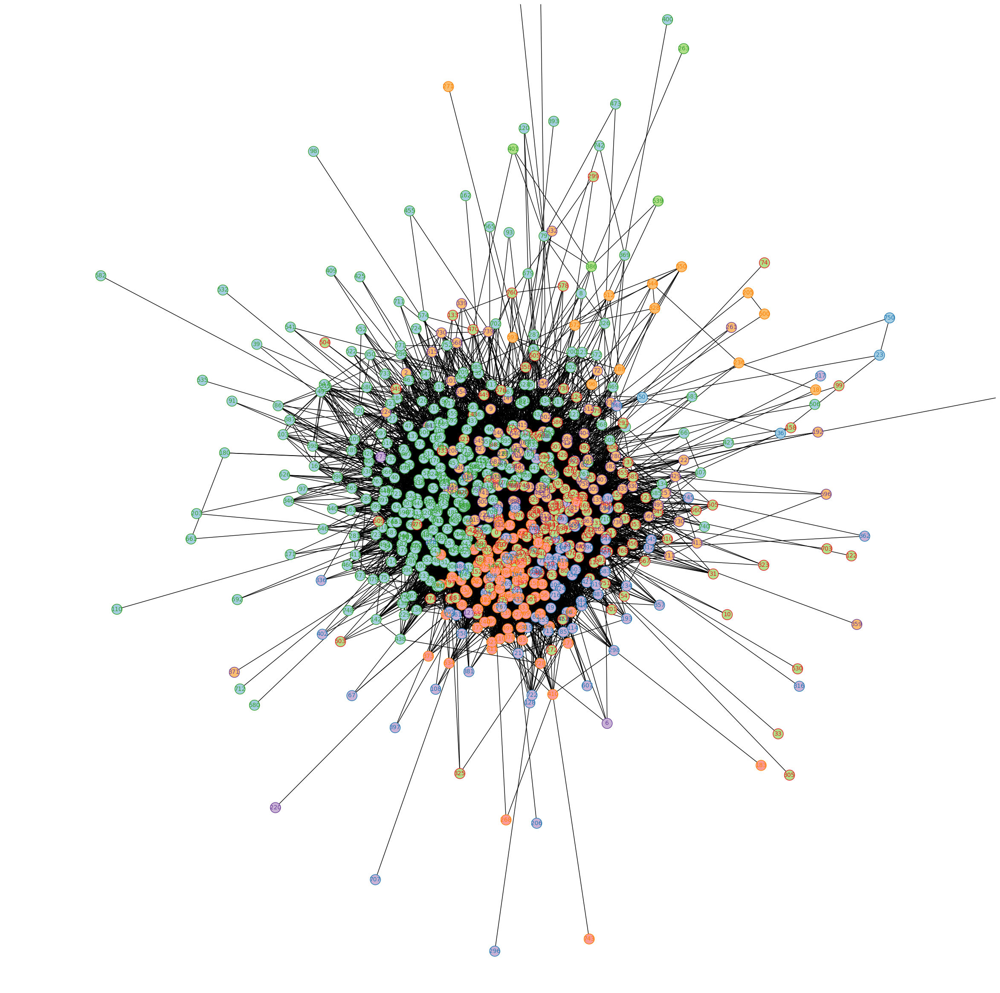

Building Infomap network from a NetworkX graph...
Find communities with Infomap...
3000 1 0.0014089440084058824 3000
Found 99 modules with codelength: 11.647367
Pos: {'0': array([0.26404573, 0.3103501 ]), '1': array([-0.07868337, -0.19992748]), '2': array([-0.01180466,  0.1619493 ]), '3': array([-0.26354942,  0.06626892]), '4': array([-0.11001139,  0.09527315]), '5': array([-0.03555637, -0.18742943]), '6': array([0.17663632, 0.05593405]), '7': array([-0.32869838,  0.24844477]), '8': array([-0.39211068,  0.38463295]), '9': array([0.03938654, 0.1009268 ]), '10': array([ 0.0601745 , -0.00975095]), '11': array([ 0.05196369, -0.64574733]), '12': array([-0.16503969,  0.45275815]), '13': array([-0.40928934,  0.41546401]), '14': array([0.09180468, 0.02669907]), '15': array([-0.00386151, -0.01176648]), '16': array([ 0.02177006, -0.0434016 ]), '17': array([0.04788405, 0.0513376 ]), '18': array([-0.23753555,  0.23611626]), '19': array([0.0671876, 0.3010802]), '20': array([ 0.0349266 , -0.07182812

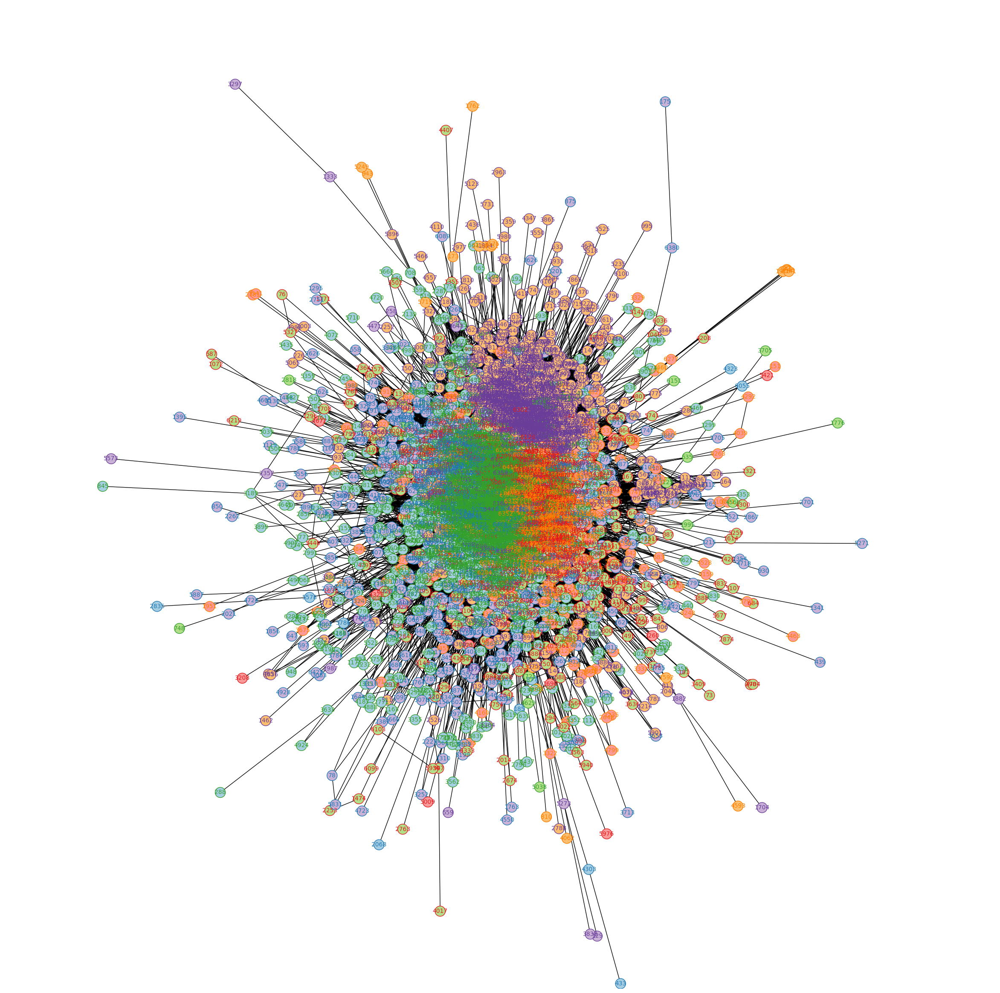

In [ ]:
analyzeGraph = ["Caltech36", "MIT8"]
for graphName in analyzeGraph:
  G = G_FB100_Dic[graphName]
  #G=nx.karate_club_graph()
  findCommunities(G)
  drawNetwork(G)

### Analyze Outcome

In [ ]:
import seaborn as sns
import matplotlib.colors as mcolors

def groupLabel(row, communities):
  return communities[row['node']];
def colorGroupLabel(row, N):
  palette = sns.color_palette(None, N+1)
  colorList = list(palette);
  return colorList[row['group_label']];
if "dfCommunityAnalysis" not in locals():
  dfCommunityAnalysis = {}
analyzeGraph = ["Caltech36", "MIT8"]
for graphName in analyzeGraph:
  G = G_FB100_Dic[graphName];
  communities = nx.get_node_attributes(G, 'community');
  print(communities.keys())
  communtiesList = list(set(communities.values()))
  print(communtiesList)
  NumOfGroup = len(communtiesList)
  print(G.nodes['0'].keys())
  print(G.nodes['0'].values())
  df_graph_2 = pd.DataFrame();
  attrList = list(G.nodes['0'].keys())
  nodeList = list(G.nodes());
  df_graph_2['node'] = nodeList
  for attr in attrList:
    print(attr, " : ",nx.get_node_attributes(G, attr).values())
    df_graph_2[attr] = list(nx.get_node_attributes(G, attr).values())

  df_graph_2['group_label'] = df_graph_2.apply(lambda x: groupLabel(x,communities), axis=1)
  df_graph_2['group_color'] = df_graph_2.apply(lambda row: colorGroupLabel(row, NumOfGroup), axis=1);
  dfCommunityAnalysis[graphName] = df_graph_2;

dict_keys(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99', '100', '101', '102', '103', '104', '105', '106', '107', '108', '109', '110', '111', '112', '113', '114', '115', '116', '117', '118', '119', '120', '121', '122', '123', '124', '125', '126', '127', '128', '129', '130', '131', '132', '133', '134', '135', '136', '137', '138', '139', '140', '141', '142', '143', '144', '145', '146', '147', '148', '149', '150', '151', '152', '153', '154', '155', '156', 

In [ ]:
df_graph_2.head(5)
#df_graph_2['group_label'].unique()

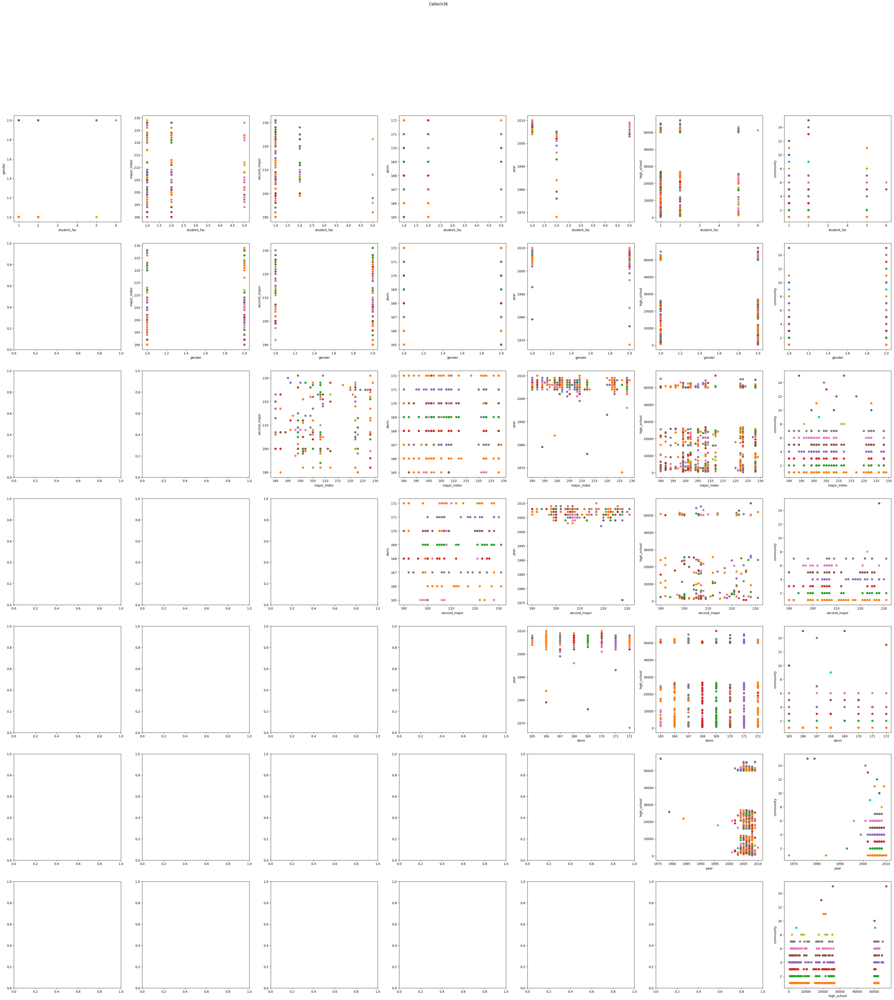

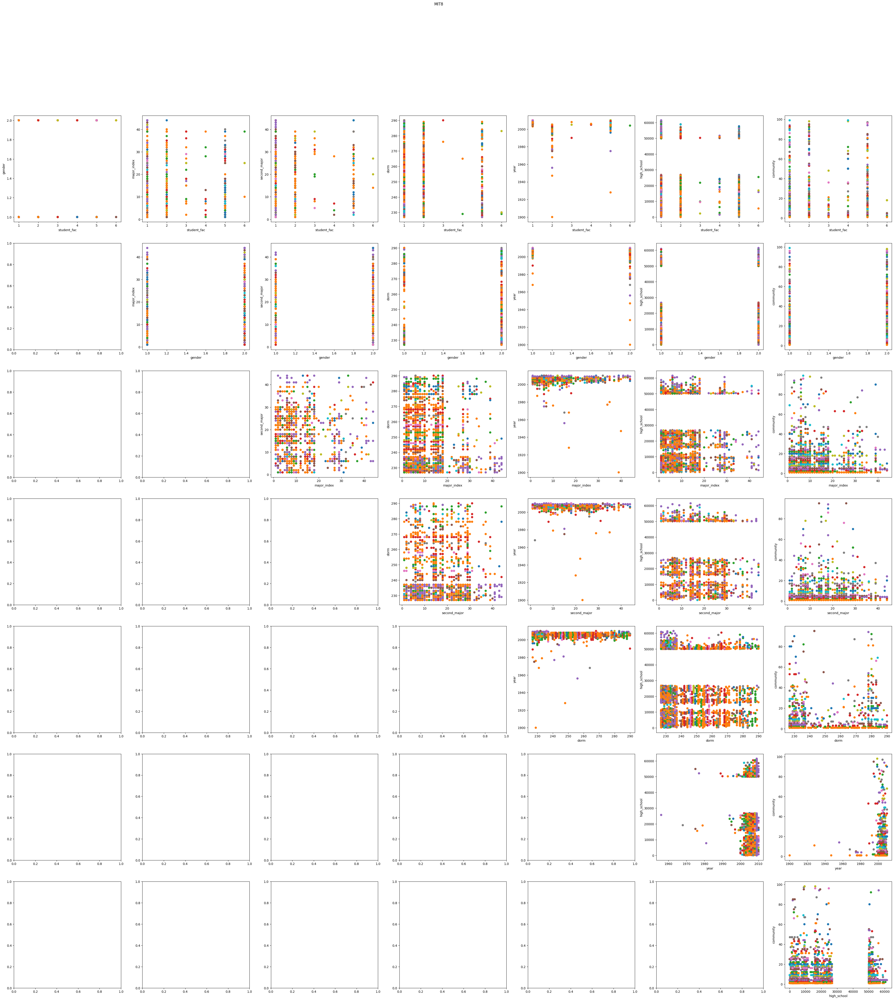

In [ ]:
analyzeGraph = ["Caltech36", "MIT8"]
for graphName in analyzeGraph:
  G = G_FB100_Dic[graphName];
  nodeList = list(G.nodes());
  attrList = list(G.nodes[nodeList[0]].keys())
  fig, axes = plt.subplots(len(attrList)-1,len(attrList)-1);
  fig.set_size_inches(50, 50)
  # Compare the group label with the two selected features in order to know which feature will influence the community more
  plt.suptitle(graphName)
  df_graph_2 = dfCommunityAnalysis[graphName];
  for i in range(len(attrList)-1):
    for j in range(i+1,len(attrList)):
      ax = axes[i][j-1];

      df = pd.concat([df_graph_2[attrList[i]], df_graph_2[attrList[j]], df_graph_2['group_color'] ], axis=1,join='outer')
      df = df[(df[attrList[i]] != 0) & (df[attrList[j]] != 0)];
      ax.scatter(df[attrList[i]],df[attrList[j]],c=df['group_color']);
      ax.set_xlabel(attrList[i]);
      ax.set_ylabel(attrList[j]);



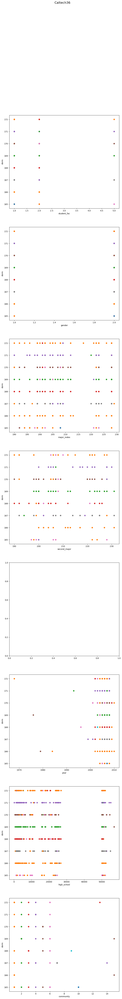

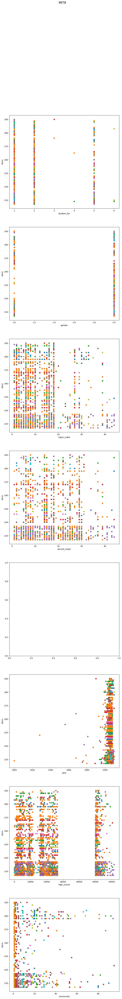

In [ ]:
analyzeGraph = ["Caltech36", "MIT8"]
for graphName in analyzeGraph:
  G = G_FB100_Dic[graphName];
  nodeList = list(G.nodes());
  attrList = list(G.nodes[nodeList[0]].keys())
  majorAttr = "dorm";
  fig, axes = plt.subplots(len(attrList));
  fig.set_size_inches(10, 10*len(attrList));
  plt.suptitle(graphName,fontsize=16)
  # Compare the group label with the two selected features in order to know which feature will influence the community more
  df_graph_2 = dfCommunityAnalysis[graphName];
  for i in range(len(attrList)):
      if attrList[i] != majorAttr:
        ax = axes[i];
        df = pd.concat([df_graph_2[attrList[i]], df_graph_2[majorAttr], df_graph_2['group_color'] ], axis=1,join='outer')
        df = df[(df[attrList[i]] != 0) & (df[majorAttr] != 0)];
        ax.scatter(df[attrList[i]],df[majorAttr],c=df['group_color']);
        ax.set_xlabel(attrList[i]);
        ax.set_ylabel(majorAttr);

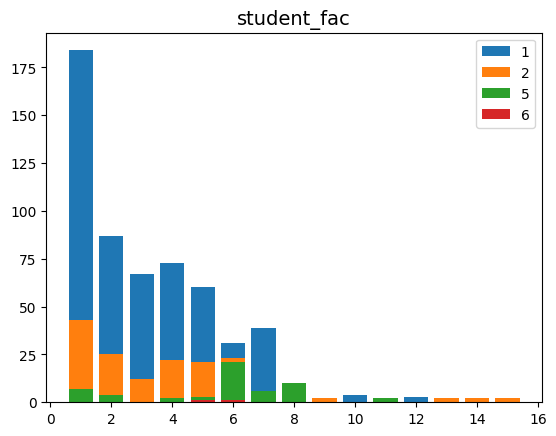

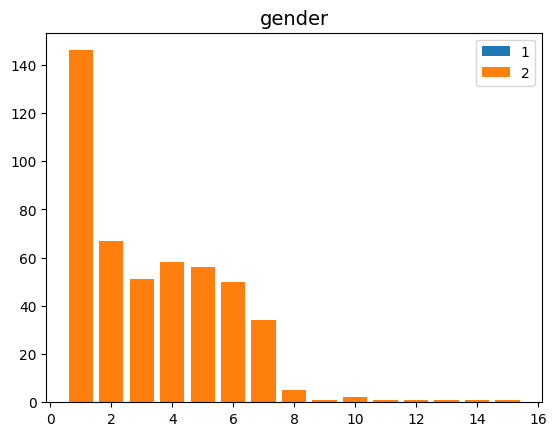

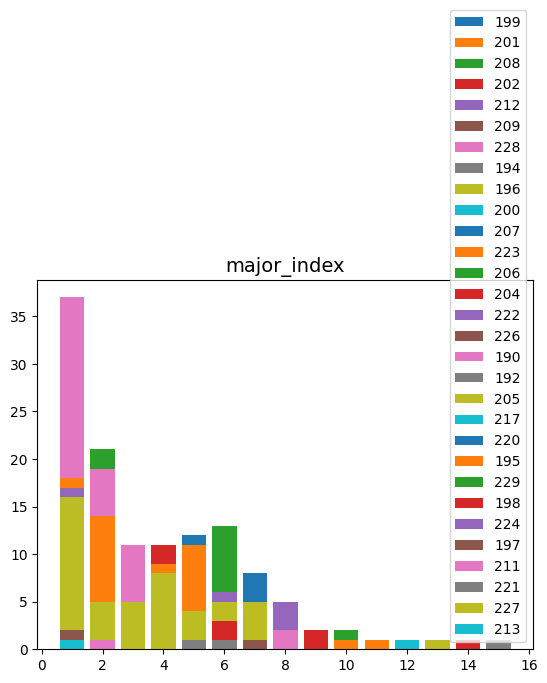

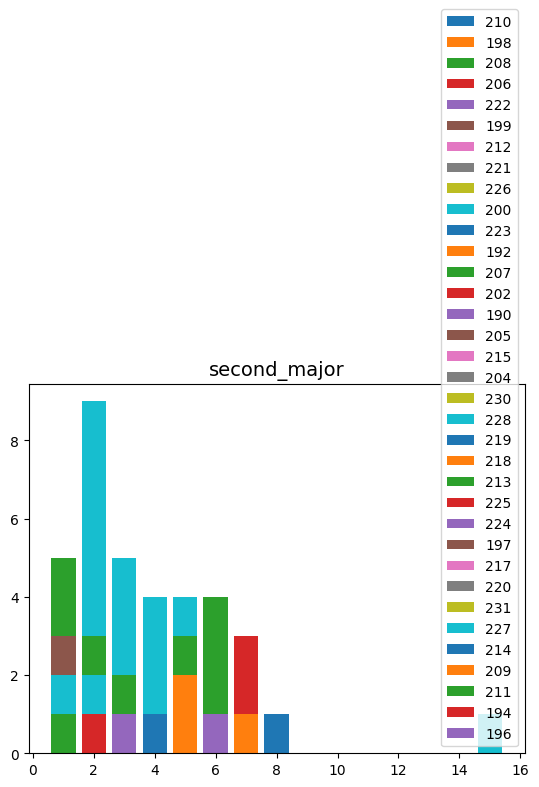

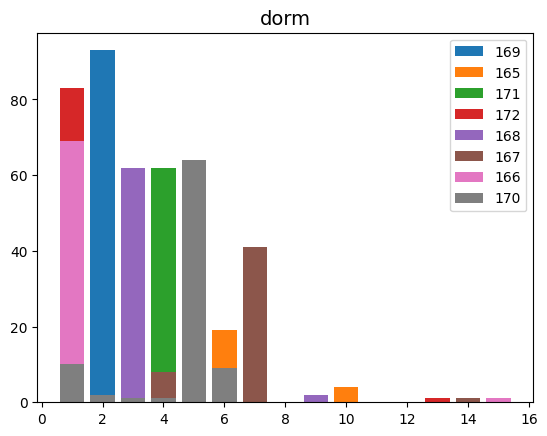

...

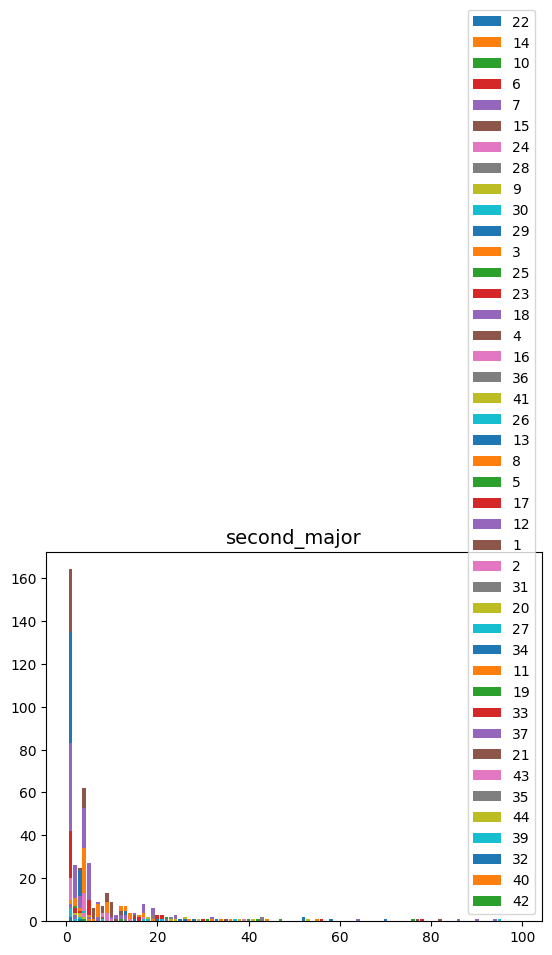

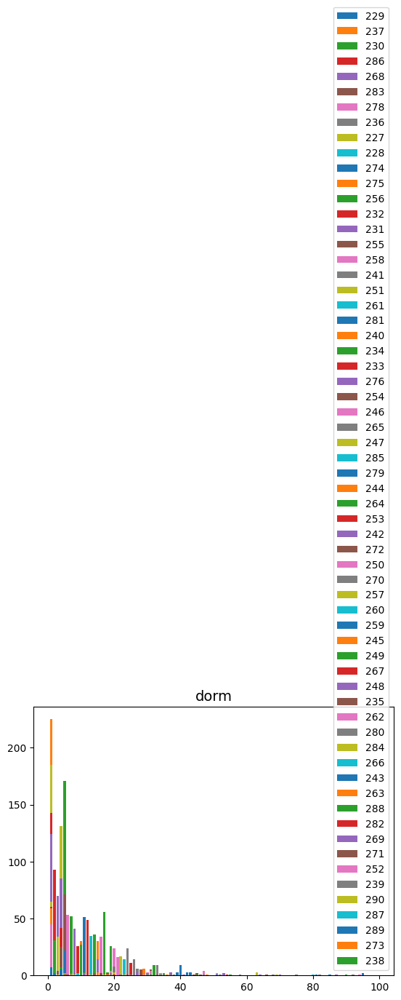

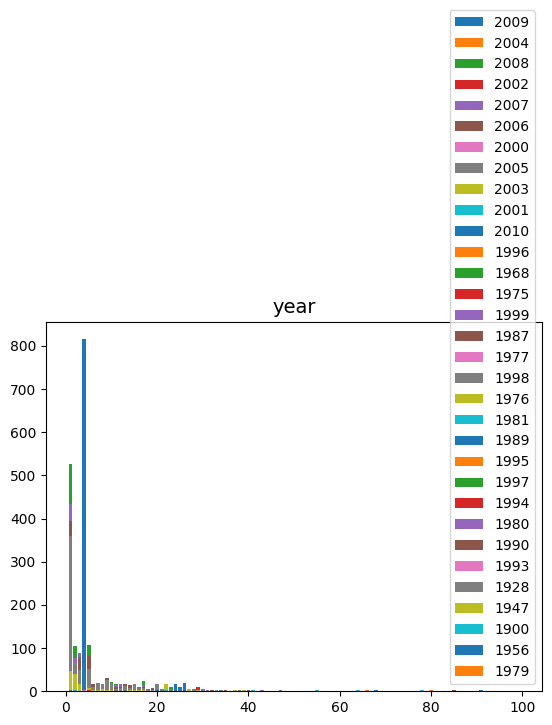

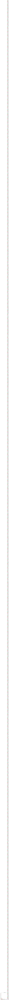

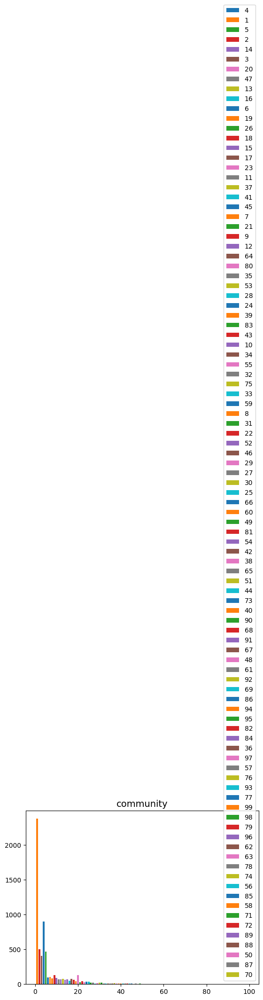

In [ ]:
analyzeGraph = ["Caltech36", "MIT8"]
for graphName in analyzeGraph:
  G = G_FB100_Dic[graphName];
  nodeList = list(G.nodes());
  attrList = list(G.nodes[nodeList[0]].keys())
  df_graph_2 = dfCommunityAnalysis[graphName]
  groupList = list(pd.unique(df_graph_2['group_label']))
  majorAttr = "dorm";
  #fig, axes = plt.subplots(len(attrList));
  #fig.set_size_inches(10, 10*len(attrList))
  # Compare the group label with the two selected features in order to know which feature will influence the community more
  dfAllAttrNum={}
  basicInfo = ["Graph","Attribute","Group"]
  print("===========",graphName,"===========")
  for group in groupList:
    df_subgroup = df_graph_2[df_graph_2['group_label']== group];
    for attr in attrList:
      attributeType = list(pd.unique(df_graph_2[attr]))
      if 0 in attributeType:
        attributeType.remove(0)
      if attr not in dfAllAttrNum.keys():
        df = pd.DataFrame(columns=basicInfo + attributeType)
        dfAllAttrNum[attr] = df;
      else:
        df = dfAllAttrNum[attr];
      newRow = [graphName, attr, group];
      for attrtype in attributeType:
        N = len(df_subgroup[df_subgroup[attr] == attrtype]);
        newRow.append(N);
      #print(newRow)
      df.loc[len(df)] = newRow;
  for attr in attrList:
    df = dfAllAttrNum[attr];
    attributeType = list(pd.unique(df_graph_2[attr]))
    if 0 in attributeType:
        attributeType.remove(0)
    fig = plt.figure()
    for attrType in attributeType:
      plt.bar(df['Group'],df[attrType],label = attrType);
    plt.title(attr, fontsize = 14)
    plt.legend()
    plt.show()
